# To Share or Not To Share: 
# A Comprehensive Appraisal of Weight-Sharing

# Figures and Data Processing
Simply run all cells and wait for a while

In [1]:
import glob
import itertools
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np
import os
import pickle
import scipy
import seaborn as sns
import sys

from scipy.stats import kendalltau, pearsonr, spearmanr, describe
from tqdm import tqdm_notebook

SEARCH_SPACES = ["4", "3", "2", "1", "full", "full_0", "full_1"]
RUNS_DIR = "../results_paper/"
os.makedirs("figures", exist_ok=True)

## Compute the best average test regret and average training time on each search spaces

In [2]:
best_regrets = {sp: 0 for sp in SEARCH_SPACES}
avg_train_time = {sp: 0 for sp in SEARCH_SPACES}
test_accs = {sp: None for sp in SEARCH_SPACES}

for sp in SEARCH_SPACES:
    
    data_name = "sp_{}".format(sp)
    with open("../datasets/{}.pkl".format(data_name), "rb") as f:
        d = pickle.load(f)
        
    accs = [np.mean([d[i][1][108][j]["final_test_accuracy"] for j in range(3)]) for i in range(len(d))]
    best_regrets[sp] = 1 - np.max(accs)
    avg_train_time[sp] = np.mean([np.mean([d[i][1][108][j]["final_training_time"] for j in range(3)]) for i in range(len(d))])
    test_accs[sp] = np.array(accs)
    
print("Best test regrets:", best_regrets)
print("Avg Training Times:", avg_train_time)

Best test regrets: {'4': 0.06413592894872033, '3': 0.0606971184412638, '2': 0.05952858924865723, '1': 0.056824247042338016, 'full': 0.056824247042338016, 'full_0': 0.05952858924865723, 'full_1': 0.056824247042338016}
Avg Training Times: {'4': 801.0056699426807, '3': 1252.595960311003, '2': 1569.8000584240058, '1': 3144.655034238751, 'full': 1932.4028811898384, 'full_0': 1783.7094953465378, 'full_1': 2561.172922703763}


## Distribution of test accuracies in the different search spaces

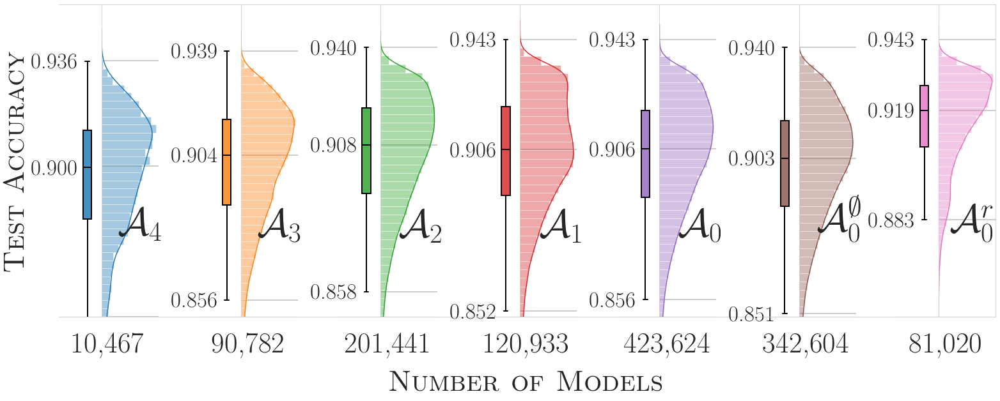

In [41]:
curr_pal = sns.color_palette(n_colors=len(SEARCH_SPACES))
cs = {sp: curr_pal[i] for i, sp in enumerate(SEARCH_SPACES)}

sns.set_style("whitegrid")
matplotlib.rcParams.update({'font.size': 45})
matplotlib.rcParams['mathtext.fontset'] = 'stix'
matplotlib.rcParams['font.family'] = 'STIXGeneral'
matplotlib.rc('text', usetex=True)

fig = plt.figure(figsize=(0.75 * 5 * len(SEARCH_SPACES), 0.75 * 12))
gs1 = fig.add_gridspec(1, len(SEARCH_SPACES), wspace=0.4)
plt.ylabel(r"\textsc{{{}}}".format("Test Accuracy"), labelpad=45)
plt.xlabel(r"\textsc{{{}}}".format("Number of Models"), labelpad=85)

ymin, ymax = 0.85, 0.955
plt.ylim(ymin, ymax)
plt.yticks([], [])
plt.xticks([], [])

for n, sp in enumerate(SEARCH_SPACES):
    
    gs2 = gs1[n].subgridspec(1, 2, wspace=-0.25)
    
    # label
    splits = sp.split('_')
    l = splits[0]
    if l == "full":
        l = 0
    m = None
    if len(splits) > 1:
        m = "r" if int(splits[1]) else "\emptyset"
    space = "$\mathcal{{A}}_{}^{}$".format(l, m) if m is not None else "$\mathcal{{A}}_{}$".format(l)
    
    # data
    d = test_accs[sp]

    # title
    ax = fig.add_subplot(gs1[n])
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    plt.xlabel(r"{},{:03d}".format(len(d)//1000, len(d)%1000), labelpad=25)
    plt.yticks([], [])
    plt.xticks([], [])

    ax = fig.add_subplot(gs2[0])
    
    # box plot
    bplot = plt.boxplot(d,
                       vert=True,  # vertical box alignment
                       patch_artist=True,  # fill with color
                       labels=["space"],
                       showfliers=False,
                       whis=[5, 100])  # will be used to label x-ticks
    
    # fill with colors
    colors = [cs[sp]]
    for patch, color in zip(bplot['boxes'], colors):
        cmap = sns.light_palette(color, n_colors=6)
        patch.set_color("black")
        patch.set_facecolor(cmap[-2])
        patch.set_linewidth(2)
    
    yticks = []
    for i, median in enumerate(bplot["medians"]):
        median.set_color("black")
        median.set_linewidth(2)
        x = median.get_xdata()
        y = median.get_ydata()
        y_t = y[1]
        x_t = x[1] - 0.7
        yticks.append(y_t)

    for i, whisker in enumerate(bplot["whiskers"]):
        whisker.set_linewidth(2)

    for i, cap in enumerate(bplot["caps"]):
        cap.set_linewidth(2)
        x, y = cap.get_xydata()[0]
        y_t = y
        yticks.append(y_t)
        
    plt.tick_params(direction="in", pad=-30, labelsize=35, width=0, grid_linewidth=0)
    plt.yticks(yticks, ["{:.3f}".format(y) for y in yticks])
    plt.xticks([], [])
    plt.ylim(ymin, ymax)
    
    ax.spines['left'].set_visible(False)
    
    ax = fig.add_subplot(gs2[1])
    
    plt.tick_params(grid_linewidth=2)
    plt.ylim(ymin, ymax)
    d_ = test_accs[sp][np.where(test_accs[sp] >= 0.8)]
    distplot = sns.distplot(d_, vertical=True, color=cs[sp], norm_hist=True)
    plt.text(7, 0.875, space, fontsize=62)
    plt.yticks(yticks, [])
    plt.xticks([], labels=[])
    
    ax.spines['right'].set_visible(False)

plt.savefig("/home/alois/workspace/nasbench-ws/notebooks/figures/spaces.png", bbox_inches="tight", pad_inches=0)
plt.show()

## Printing Training and Evaluation Seeds of all models

In [4]:
sys.path.append("..")
import utils

exp_names = [
    "baseline_no_ft",
    "baseline_ft_bn",
    "pro-rata_ft_bn",
    "single-k_ft_bn",
    "avg-3_ft_bn",
    "s-k+p-r_ft_bn"
]

for exp_name in exp_names:
    print("Experience: {}\n".format(exp_name))
    for sp in SEARCH_SPACES:
        print("Search Space: {}".format(sp))
        for i in range(5):
            with open(os.path.join(RUNS_DIR, exp_name, sp, str(i), "params_dict.pkl"), "rb") as f:
                train_params = pickle.load(f)
            with open(os.path.join(RUNS_DIR, exp_name, sp, str(i), "params_dict_eval.pkl"), "rb") as f:
                eval_params = pickle.load(f)
            print("Run n°{}: train seed: {}; evaluation seed: {}".format(i, train_params["train_seed"], eval_params["eval_seed"]))
        print("\n")

Experience: baseline_no_ft

Search Space: 4
Run n°0: train seed: 203278; evaluation seed: 105656
Run n°1: train seed: 881077; evaluation seed: 282025
Run n°2: train seed: 429588; evaluation seed: 912079
Run n°3: train seed: 399339; evaluation seed: 88363
Run n°4: train seed: 657742; evaluation seed: 88363


Search Space: 3
Run n°0: train seed: 136170; evaluation seed: 864956
Run n°1: train seed: 125729; evaluation seed: 507801
Run n°2: train seed: 594586; evaluation seed: 794381
Run n°3: train seed: 270852; evaluation seed: 9113
Run n°4: train seed: 839405; evaluation seed: 119558


Search Space: 2
Run n°0: train seed: 19130; evaluation seed: 648617
Run n°1: train seed: 558429; evaluation seed: 146885
Run n°2: train seed: 468268; evaluation seed: 327749
Run n°3: train seed: 624172; evaluation seed: 334266
Run n°4: train seed: 547522; evaluation seed: 427083


Search Space: 1
Run n°0: train seed: 806361; evaluation seed: 26236
Run n°1: train seed: 194740; evaluation seed: 834758
Run n°2

## Visualizing correlations on search spaces

In [5]:
def plot_corrs(exp_name, indexes, search_spaces=SEARCH_SPACES, limit=0.85, size=(8, 35), wspace=0.1, bias=None, save=True, top_k=None):

    sns.set_style("whitegrid")
    matplotlib.rcParams.update({'font.size': 35})
    matplotlib.rcParams['mathtext.fontset'] = 'stix'
    matplotlib.rcParams['font.family'] = 'STIXGeneral'
    matplotlib.rc('text', usetex=True)
    
    current_palette = sns.color_palette(n_colors=len(SEARCH_SPACES))
    cs = {sp: current_palette[i] for i, sp in enumerate(SEARCH_SPACES)}
    taus = {sp: {"Kendall": [], "Spearman": [], "Pearson": []} for sp in search_spaces}
    np.random.seed(999)
    ymin, ymax = 0.85, 0.955
    size[0] = size[0] + wspace * (len(indexes) - 1)
    
    for n, sp in enumerate(search_spaces):

        tmp_1s = []
        tmp_2s = []
        tmp_3s = []
        
        tau_ks = []
        tau_ss = []
        tau_ps = []
        
        for index in indexes:

            path = "{}/{}/{}/{}/eval_results.pkl".format(RUNS_DIR, exp_name, sp, index)
            with open(path, "rb") as f:
                results = pickle.load(f)

            tmp_1 = np.array([np.mean([res["bench_metrics"][i]["final_validation_accuracy"] for i in range(3)]) for res in results])
            tmp_2 = np.array([res["proxy_metrics"]["final_validation_accuracy"] for res in results])
            tmp_3 = np.array([res["architecture"] for res in results])
            
            if top_k is not None:
                arg_sort = np.argsort(tmp_2)
                tmp_1 = np.array([tmp_1[i] for i in arg_sort[-top_k:]])
                tmp_2 = np.array([tmp_2[i] for i in arg_sort[-top_k:]])
                tmp_3 = np.array([tmp_3[i] for i in arg_sort[-top_k:]])
            
            tau_ks.append(kendalltau(tmp_1, tmp_2)[0])
            tau_ss.append(spearmanr(tmp_1, tmp_2)[0])
            tau_ps.append(pearsonr(tmp_1, tmp_2)[0])
            
            idx = [i for i in range(len(tmp_1)) if tmp_1[i] >= ymin]
            tmp_1 = np.array([tmp_1[i] for i in idx])
            tmp_2 = np.array([tmp_2[i] for i in idx])
            tmp_3 = np.array([tmp_3[i] for i in idx])

            tmp_1s.append(tmp_1)
            tmp_2s.append(tmp_2)
            tmp_3s.append(tmp_3)

        taus[sp]["Kendall"] = tau_ks
        taus[sp]["Spearman"] = tau_ss
        taus[sp]["Pearson"] = tau_ps

        splits = sp.split('_')
        l = splits[0]
        if l == "full":
            l = 0
        m = None
        if len(splits) > 1:
            m = "r" if int(splits[1]) else "\emptyset"
        space = "\mathcal{{A}}_{}^{}".format(l, m) if m is not None else "\mathcal{{A}}_{}".format(l)
        
        fig = plt.figure(figsize=size)
        plt.xlabel(r"\textsc{{{}}}".format("nasbench (\%acc)"), labelpad=80)
        plt.ylabel(r"\textsc{{{}}}".format("weight-sharing (\%acc)"), labelpad=55)
        plt.yticks([], [])
        plt.xticks([], [])
        ax = fig.gca()
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)
        
        gs1 = fig.add_gridspec(1, len(indexes), wspace=0.1) 
        
        for j in range(len(tmp_1s)):
            
            r = 0.85
            gs2 = gs1[j].subgridspec(2, 2, width_ratios=[r, 1 - r], height_ratios=[1 - r, r], wspace=0.0, hspace=0.0)
            
            ax = fig.add_subplot(gs1[j])
            ax.spines['top'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.spines['bottom'].set_visible(False)
            ax.spines['left'].set_visible(False)
            plt.yticks([], [])
            plt.xticks([], [])
            
            cmap = sns.light_palette(cs[sp], n_colors=4)
            if bias is not None:
                colors = [cmap[bias(task[0], task[1]) + 1] for task in tmp_3s[j]]
            else:
                colors = [cmap[-1] for _ in tmp_3s[j]]
                
            ax = fig.add_subplot(gs2[1, 0])
            ax.scatter(tmp_1s[j], tmp_2s[j], c=colors, alpha=0.75, marker="o", s=20)
            xticks = ax.get_xticks()
            yticks = ax.get_yticks()
            ax.set_xticks([float("{:.2f}".format(t)) for t in xticks[1:-1]])
            ax.set_yticks([float("{:.1f}".format(t)) for t in yticks[1:-1]])
            x_s_min, x_s_max = ax.get_xlim()
            y_s_min, y_s_max = ax.get_ylim()
            plt.xlabel(r"$\rho_s={:.2f}$".format(tau_ss[j]), labelpad=10)
            
            ax = fig.add_subplot(gs2[0, 0])
            plt.tick_params(grid_linewidth=2)
            ax.spines['top'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.spines['bottom'].set_visible(True)
            ax.spines['left'].set_visible(False)
            plt.yticks([], [])
            plt.xticks([], [])
            plt.xlim(x_s_min, x_s_max)
            try:
                distplot = sns.distplot(tmp_1s[j], vertical=False, color=cs[sp], norm_hist=True, kde=True)
            except:
                pass
            
            ax = fig.add_subplot(gs2[1, 1])
            plt.tick_params(grid_linewidth=2)
            ax.spines['top'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.spines['bottom'].set_visible(False)
            ax.spines['left'].set_visible(True)
            plt.yticks([], [])
            plt.xticks([], [])
            plt.ylim(y_s_min, y_s_max)
            try:
                distplot = sns.distplot(tmp_2s[j], vertical=True, color=cs[sp], norm_hist=True, kde=True)
            except:
                pass
            
            if j == len(tmp_1s) - 1:
                ax = fig.add_subplot(gs2[0, 1])
                plt.text(0.05, 0.05, r'${}$'.format(space), transform=plt.gca().transAxes, fontsize=60)
                ax.spines['top'].set_visible(False)
                ax.spines['right'].set_visible(False)
                ax.spines['bottom'].set_visible(False)
                ax.spines['left'].set_visible(False)
                plt.yticks([], [])
                plt.xticks([], [])
            
        plt.savefig(os.path.join("figures", "scatter_" + sp + "_" + exp_name + ".png"),  bbox_inches = 'tight')
        plt.show()
        
    return taus    

In [6]:
def print_corrs_stats(taus):
    
    for sp in SEARCH_SPACES:
        print("Search Space: {}".format(sp))
        print("Average Metrics:")
        for key, value in taus[sp].items():
            for i in value:
                if np.isnan(i):
                    value.remove(i)
                    
            print("{}: {:.2f} +- {:.2f}".format(key, np.mean(value), 1.96 * np.std(value) / np.sqrt(len(value))))
        print("\n")

### no fine-tuning

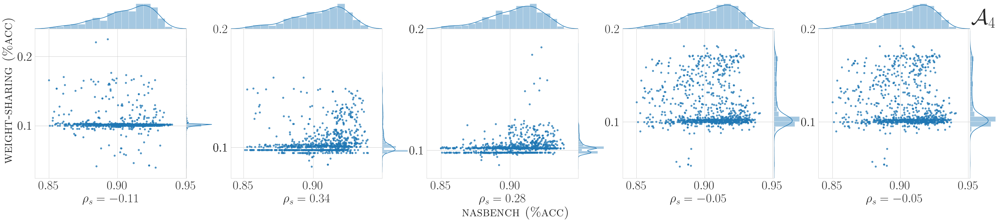

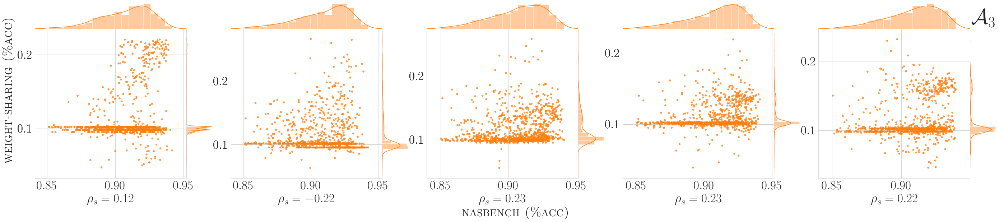

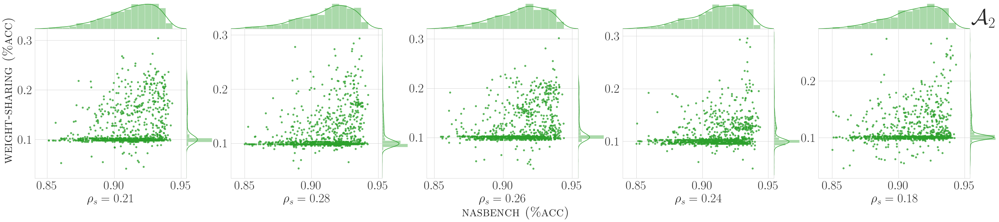

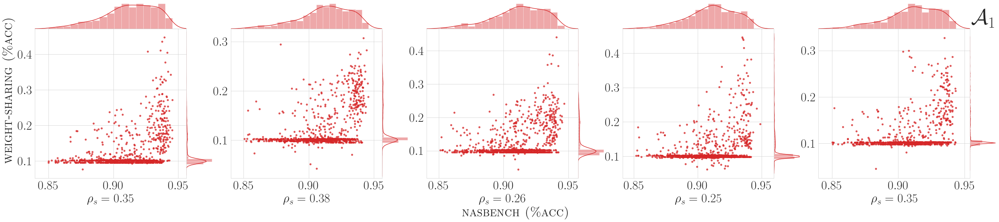

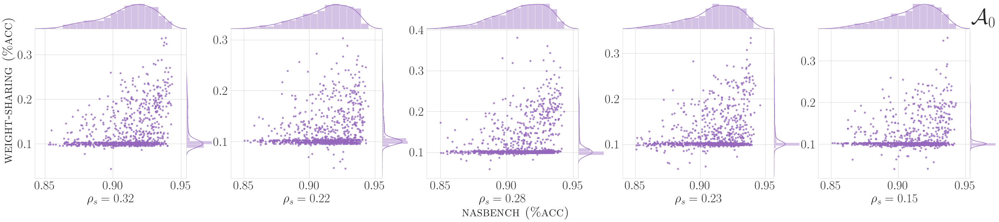

/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/numpy/lib/function_base.py:2530: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/numpy/lib/function_base.py:2531: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in greater
  return (a < x) & (x < b)
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in less
  return (a < x) & (x < b)
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:1912: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= _a)
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/stats.py:3508: PearsonRConstantInp

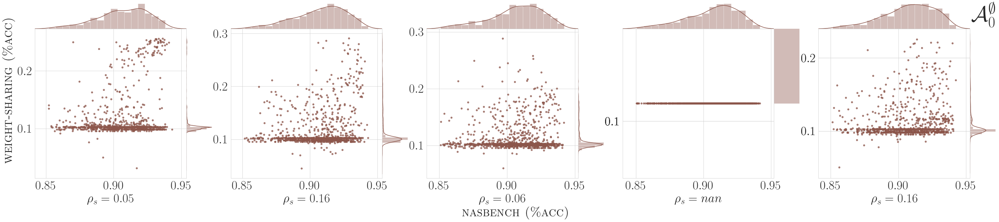

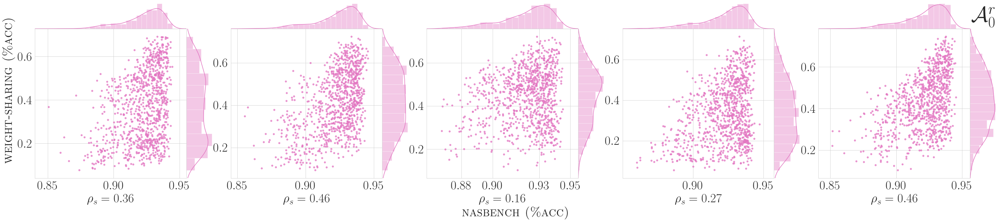

In [7]:
indexes = range(5)
taus = plot_corrs("baseline_no_ft", indexes, size=[0.75 * 12 * len(indexes), 0.75 * 12], bias=None, wspace=0.75, limit=0.75, top_k=None)

In [8]:
print_corrs_stats(taus)

Search Space: 4
Average Metrics:
Kendall: 0.06 +- 0.12
Spearman: 0.08 +- 0.17
Pearson: 0.01 +- 0.09


Search Space: 3
Average Metrics:
Kendall: 0.08 +- 0.10
Spearman: 0.12 +- 0.15
Pearson: 0.09 +- 0.04


Search Space: 2
Average Metrics:
Kendall: 0.16 +- 0.02
Spearman: 0.24 +- 0.03
Pearson: 0.12 +- 0.03


Search Space: 1
Average Metrics:
Kendall: 0.22 +- 0.04
Spearman: 0.32 +- 0.05
Pearson: 0.18 +- 0.03


Search Space: full
Average Metrics:
Kendall: 0.17 +- 0.03
Spearman: 0.24 +- 0.05
Pearson: 0.15 +- 0.02


Search Space: full_0
Average Metrics:
Kendall: 0.07 +- 0.03
Spearman: 0.11 +- 0.05
Pearson: 0.07 +- 0.04


Search Space: full_1
Average Metrics:
Kendall: 0.24 +- 0.07
Spearman: 0.34 +- 0.10
Pearson: 0.30 +- 0.04




### batch-norm stats fine-tuning

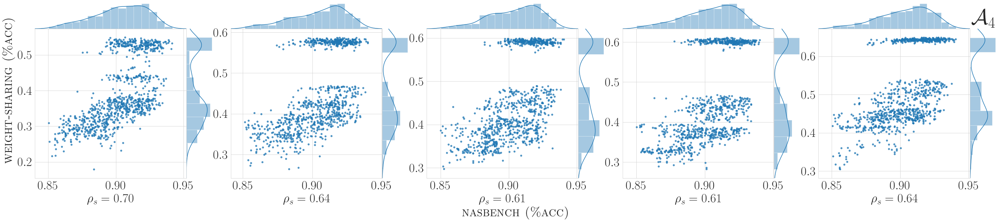

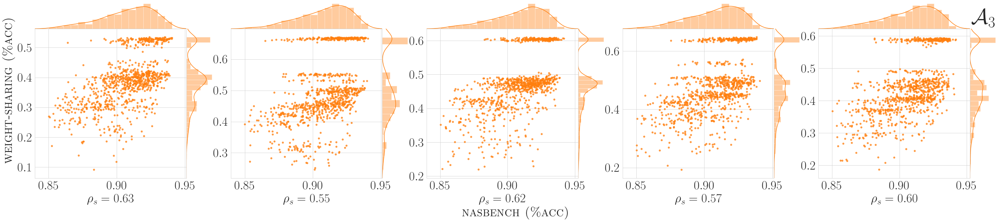

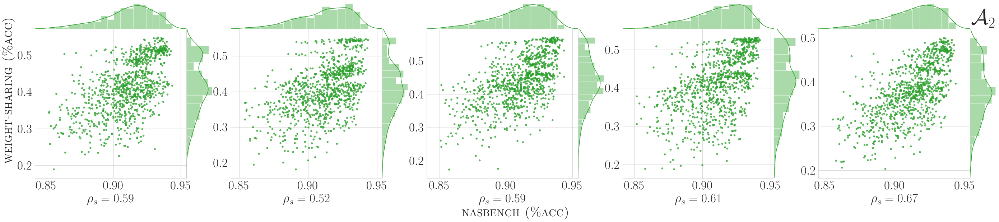

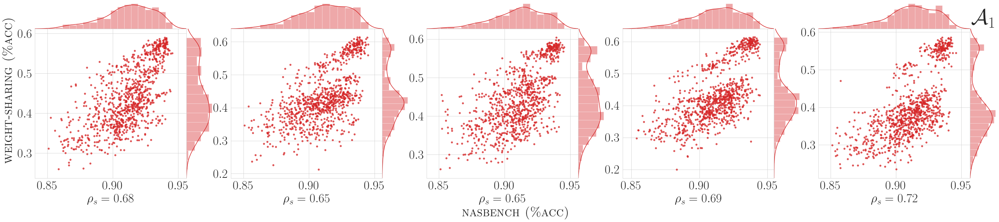

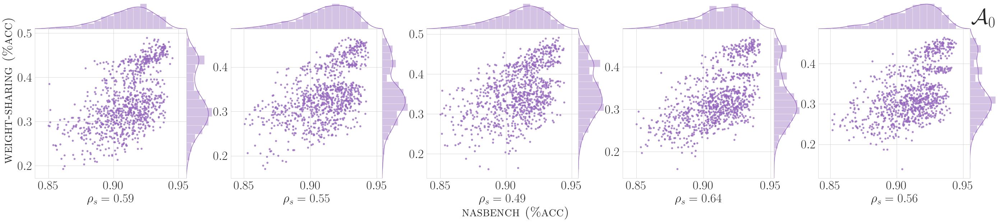

/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/numpy/lib/function_base.py:2530: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/numpy/lib/function_base.py:2531: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in greater
  return (a < x) & (x < b)
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in less
  return (a < x) & (x < b)
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:1912: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= _a)
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/stats.py:3508: PearsonRConstantInp

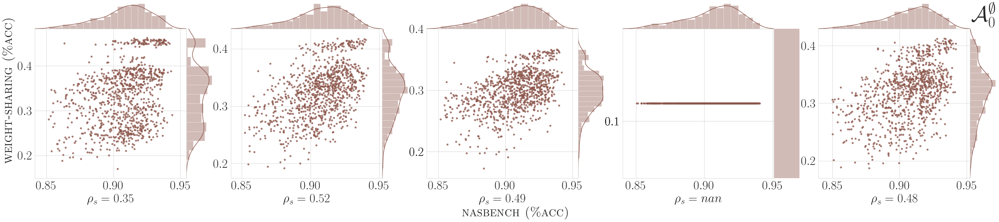

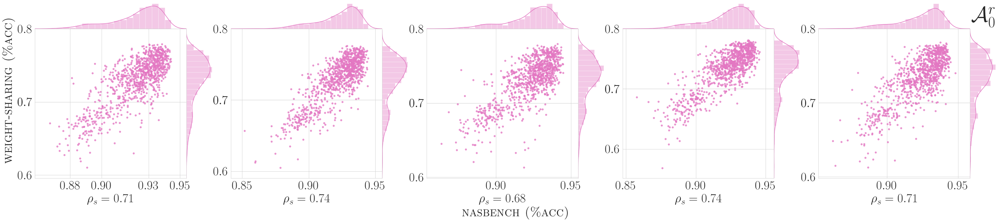

In [9]:
indexes = range(5)
taus = plot_corrs("baseline_ft_bn", indexes, size=[0.75 * 12 * len(indexes), 0.75 * 12], bias=None, wspace=0.75, limit=0.75, top_k=None)

In [10]:
print_corrs_stats(taus)

Search Space: 4
Average Metrics:
Kendall: 0.45 +- 0.03
Spearman: 0.64 +- 0.03
Pearson: 0.35 +- 0.06


Search Space: 3
Average Metrics:
Kendall: 0.42 +- 0.02
Spearman: 0.59 +- 0.03
Pearson: 0.27 +- 0.05


Search Space: 2
Average Metrics:
Kendall: 0.42 +- 0.03
Spearman: 0.60 +- 0.04
Pearson: 0.29 +- 0.06


Search Space: 1
Average Metrics:
Kendall: 0.50 +- 0.02
Spearman: 0.68 +- 0.02
Pearson: 0.33 +- 0.02


Search Space: full
Average Metrics:
Kendall: 0.40 +- 0.03
Spearman: 0.56 +- 0.04
Pearson: 0.28 +- 0.02


Search Space: full_0
Average Metrics:
Kendall: 0.32 +- 0.04
Spearman: 0.46 +- 0.06
Pearson: 0.24 +- 0.04


Search Space: full_1
Average Metrics:
Kendall: 0.53 +- 0.02
Spearman: 0.71 +- 0.02
Pearson: 0.61 +- 0.08




### batch-norm stats fine-tuning + pro-rata

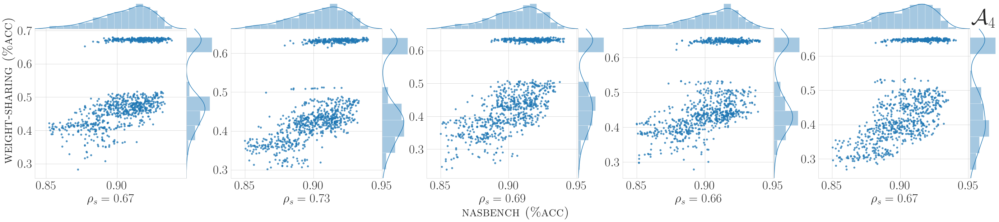

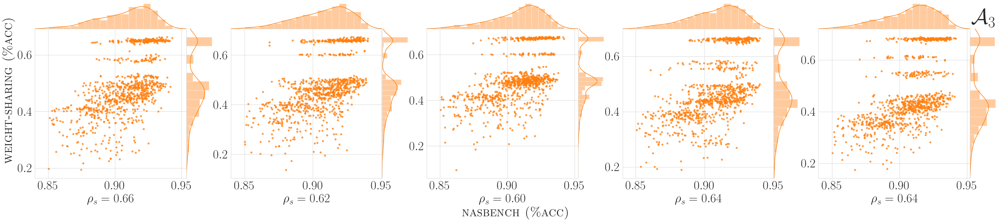

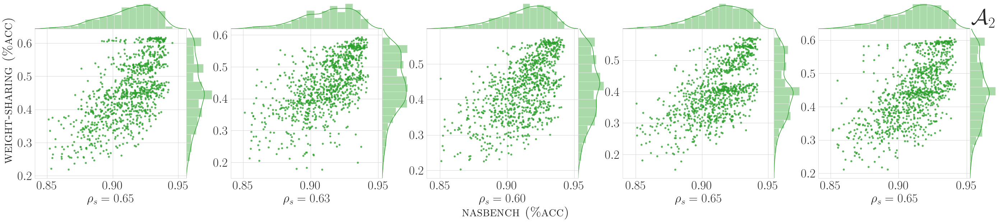

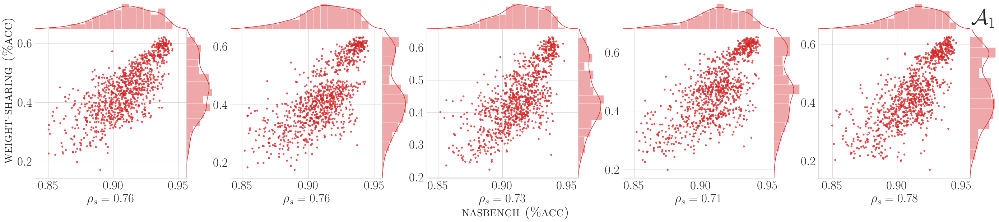

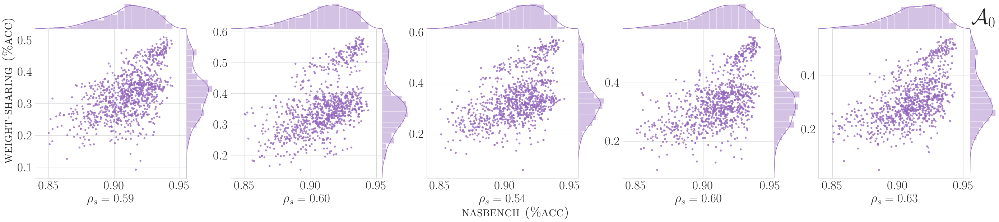

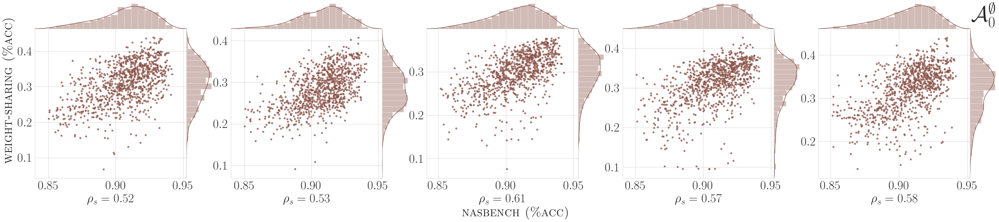

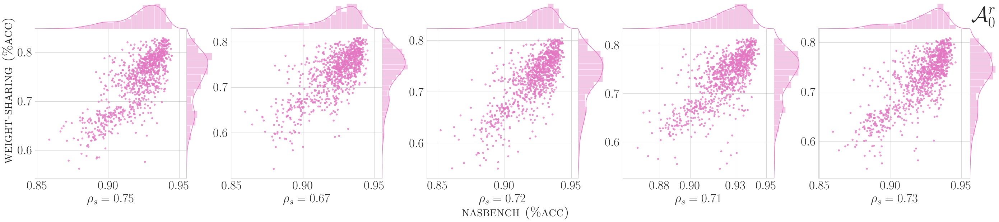

In [11]:
indexes = range(5)
taus = plot_corrs("pro-rata_ft_bn", indexes, size=[0.75 * 12 * len(indexes), 0.75 * 12], bias=None, wspace=0.75, limit=0.75, top_k=None)

In [12]:
print_corrs_stats(taus)

Search Space: 4
Average Metrics:
Kendall: 0.49 +- 0.02
Spearman: 0.68 +- 0.03
Pearson: 0.39 +- 0.07


Search Space: 3
Average Metrics:
Kendall: 0.45 +- 0.01
Spearman: 0.63 +- 0.02
Pearson: 0.30 +- 0.06


Search Space: 2
Average Metrics:
Kendall: 0.46 +- 0.02
Spearman: 0.64 +- 0.02
Pearson: 0.33 +- 0.03


Search Space: 1
Average Metrics:
Kendall: 0.56 +- 0.02
Spearman: 0.75 +- 0.02
Pearson: 0.36 +- 0.03


Search Space: full
Average Metrics:
Kendall: 0.42 +- 0.02
Spearman: 0.59 +- 0.03
Pearson: 0.31 +- 0.03


Search Space: full_0
Average Metrics:
Kendall: 0.40 +- 0.02
Spearman: 0.56 +- 0.03
Pearson: 0.24 +- 0.05


Search Space: full_1
Average Metrics:
Kendall: 0.54 +- 0.02
Spearman: 0.72 +- 0.02
Pearson: 0.58 +- 0.07




### batch-norm stats fine-tuning + single-path

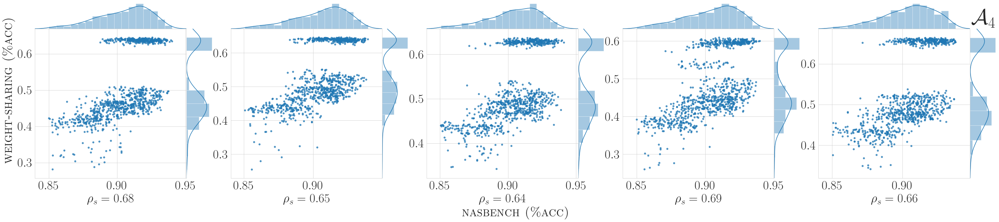

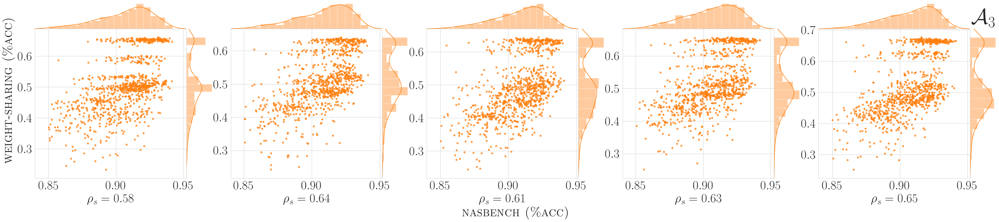

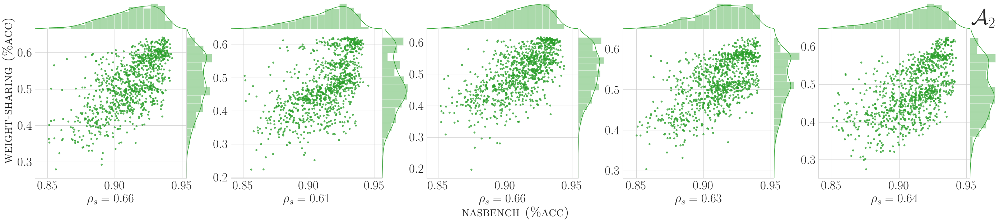

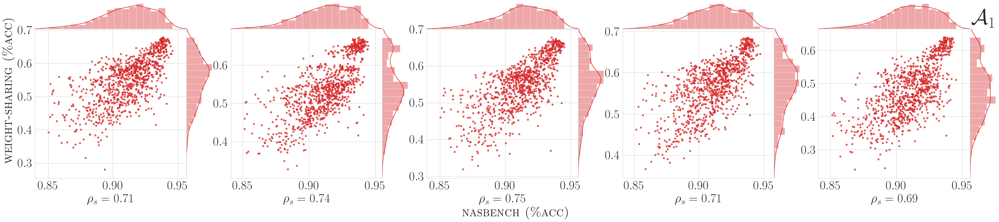

/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/numpy/lib/function_base.py:2530: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/numpy/lib/function_base.py:2531: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in greater
  return (a < x) & (x < b)
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in less
  return (a < x) & (x < b)
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:1912: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= _a)
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/stats.py:3508: PearsonRConstantInp

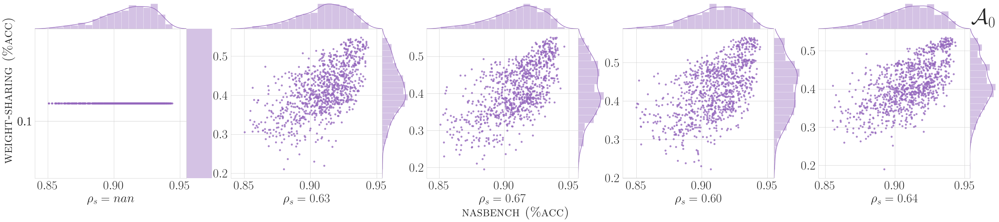

/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/numpy/lib/function_base.py:2530: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/numpy/lib/function_base.py:2531: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in greater
  return (a < x) & (x < b)
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in less
  return (a < x) & (x < b)
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:1912: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= _a)
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/stats.py:3508: PearsonRConstantInp

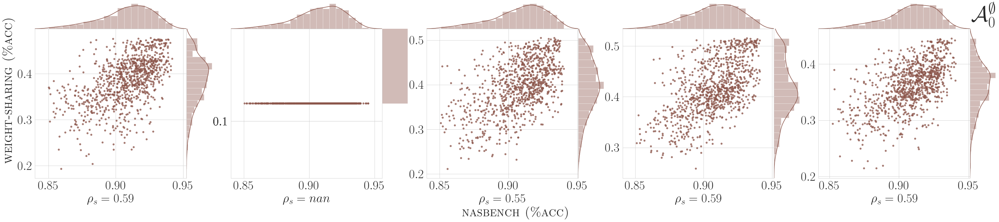

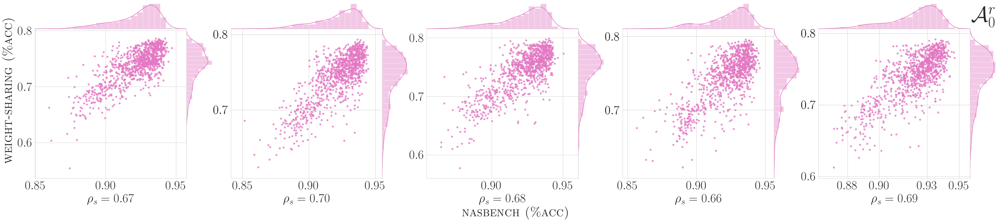

In [13]:
indexes = range(5)
taus = plot_corrs("single-k_ft_bn", indexes, size=[0.75 * 12 * len(indexes), 0.75 * 12], bias=None, wspace=0.75, limit=0.75, top_k=None)

In [14]:
print_corrs_stats(taus)

Search Space: 4
Average Metrics:
Kendall: 0.47 +- 0.01
Spearman: 0.66 +- 0.01
Pearson: 0.34 +- 0.07


Search Space: 3
Average Metrics:
Kendall: 0.44 +- 0.02
Spearman: 0.62 +- 0.02
Pearson: 0.32 +- 0.05


Search Space: 2
Average Metrics:
Kendall: 0.46 +- 0.01
Spearman: 0.64 +- 0.02
Pearson: 0.30 +- 0.07


Search Space: 1
Average Metrics:
Kendall: 0.53 +- 0.02
Spearman: 0.72 +- 0.02
Pearson: 0.38 +- 0.02


Search Space: full
Average Metrics:
Kendall: 0.45 +- 0.02
Spearman: 0.63 +- 0.02
Pearson: 0.35 +- 0.03


Search Space: full_0
Average Metrics:
Kendall: 0.41 +- 0.02
Spearman: 0.58 +- 0.02
Pearson: 0.30 +- 0.03


Search Space: full_1
Average Metrics:
Kendall: 0.50 +- 0.01
Spearman: 0.68 +- 0.01
Pearson: 0.64 +- 0.04




### batch-norm stats fine-tuning + 3 model averaging

/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/numpy/lib/function_base.py:2530: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/numpy/lib/function_base.py:2531: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in greater
  return (a < x) & (x < b)
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:903: RuntimeWarning: invalid value encountered in less
  return (a < x) & (x < b)
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/_distn_infrastructure.py:1912: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= _a)
/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/stats.py:3508: PearsonRConstantInp

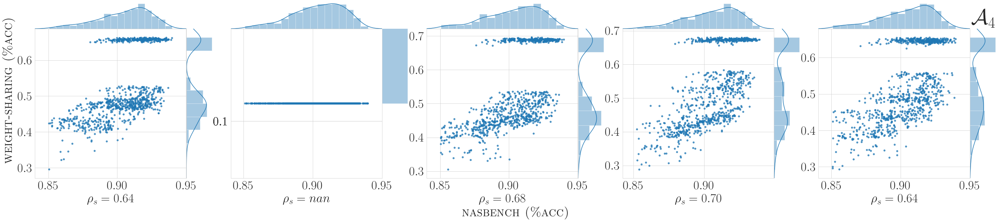

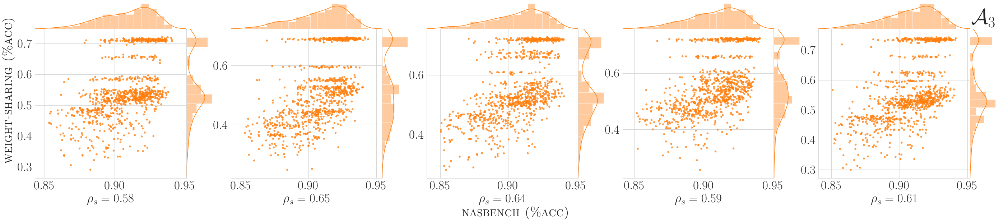

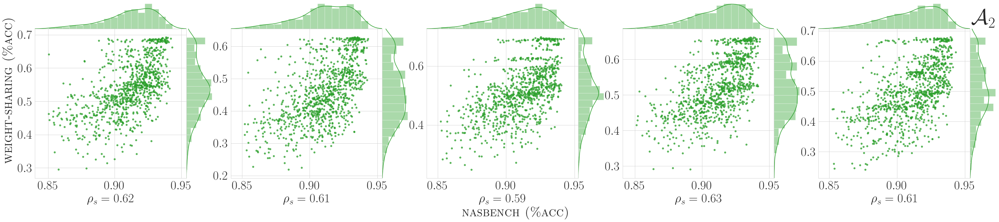

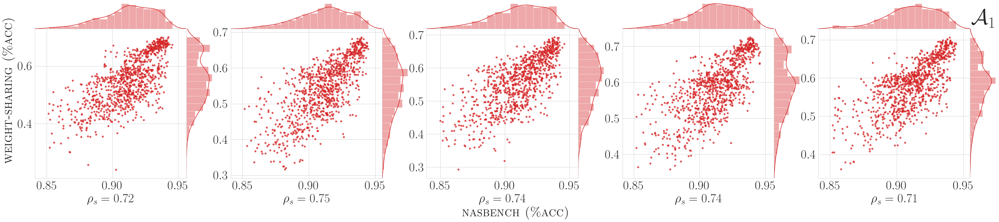

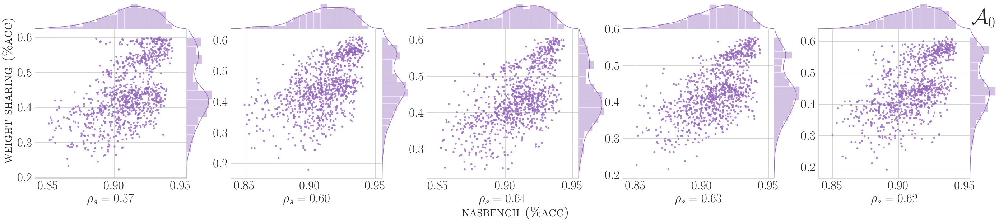

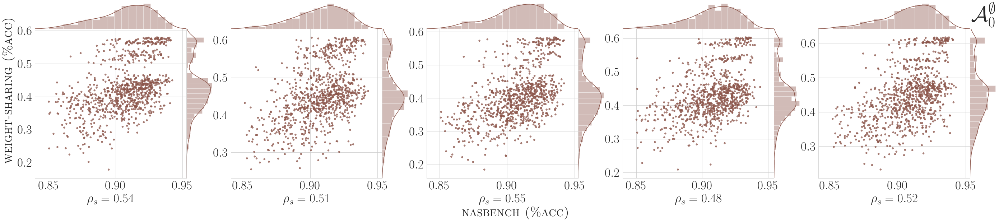

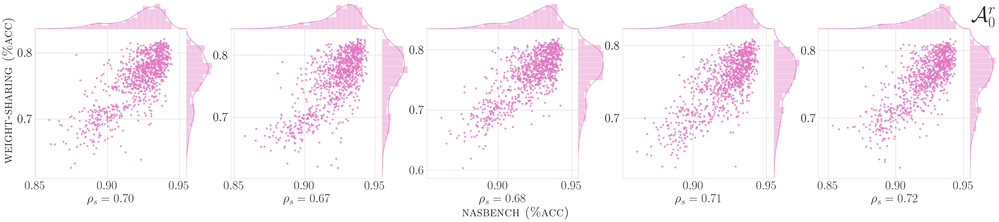

In [15]:
indexes = range(5)
taus = plot_corrs("avg-3_ft_bn", indexes, size=[0.75 * 12 * len(indexes), 0.75 * 12], bias=None, wspace=0.75, limit=0.75, top_k=None)

In [16]:
print_corrs_stats(taus)

Search Space: 4
Average Metrics:
Kendall: 0.48 +- 0.02
Spearman: 0.67 +- 0.02
Pearson: 0.36 +- 0.07


Search Space: 3
Average Metrics:
Kendall: 0.43 +- 0.02
Spearman: 0.61 +- 0.03
Pearson: 0.31 +- 0.04


Search Space: 2
Average Metrics:
Kendall: 0.44 +- 0.01
Spearman: 0.61 +- 0.01
Pearson: 0.27 +- 0.04


Search Space: 1
Average Metrics:
Kendall: 0.55 +- 0.01
Spearman: 0.73 +- 0.01
Pearson: 0.41 +- 0.04


Search Space: full
Average Metrics:
Kendall: 0.44 +- 0.02
Spearman: 0.61 +- 0.02
Pearson: 0.30 +- 0.02


Search Space: full_0
Average Metrics:
Kendall: 0.36 +- 0.02
Spearman: 0.52 +- 0.02
Pearson: 0.26 +- 0.03


Search Space: full_1
Average Metrics:
Kendall: 0.51 +- 0.01
Spearman: 0.69 +- 0.02
Pearson: 0.63 +- 0.04




### batch-norm stats fine-tuning + single path + pro-rata

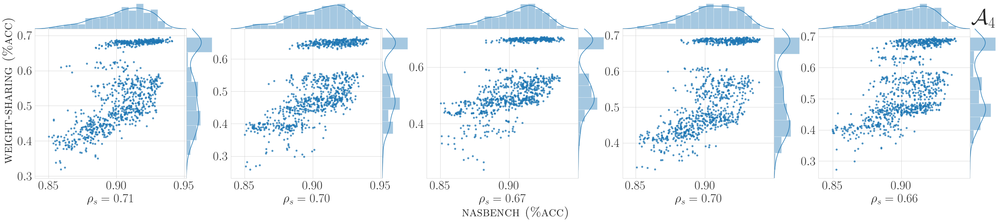

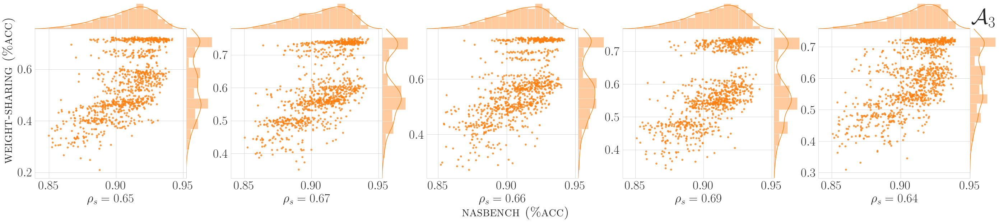

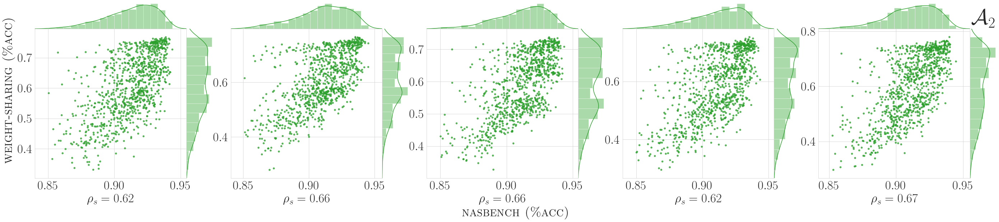

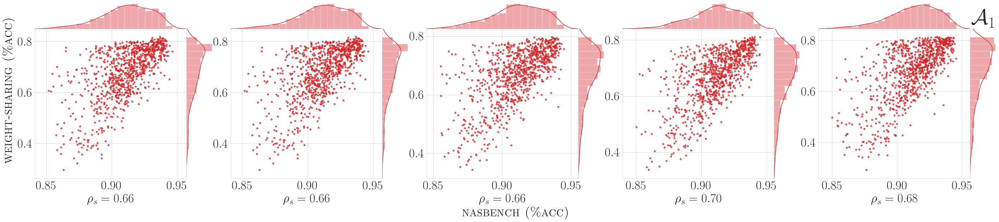

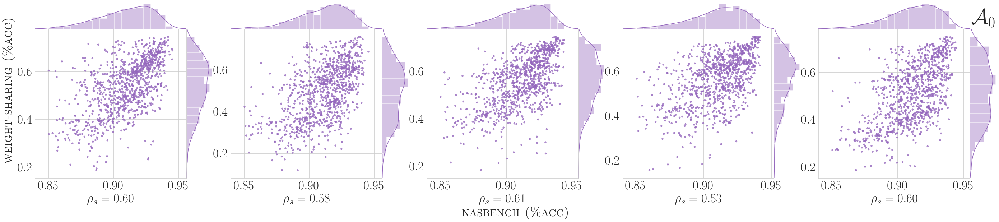

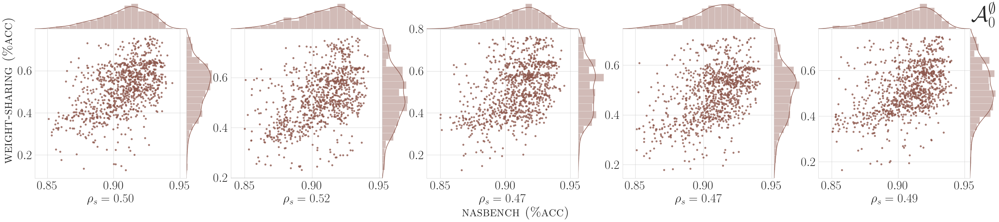

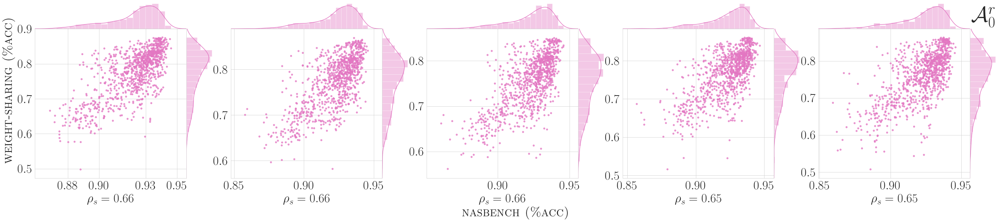

In [17]:
indexes = range(5)
taus = plot_corrs("s-k+p-r_ft_bn", indexes, size=[0.75 * 12 * len(indexes), 0.75 * 12], bias=None, wspace=0.75, limit=0.75, top_k=None)

In [18]:
print_corrs_stats(taus)

Search Space: 4
Average Metrics:
Kendall: 0.50 +- 0.02
Spearman: 0.69 +- 0.02
Pearson: 0.41 +- 0.07


Search Space: 3
Average Metrics:
Kendall: 0.48 +- 0.01
Spearman: 0.66 +- 0.02
Pearson: 0.38 +- 0.06


Search Space: 2
Average Metrics:
Kendall: 0.47 +- 0.01
Spearman: 0.65 +- 0.02
Pearson: 0.29 +- 0.03


Search Space: 1
Average Metrics:
Kendall: 0.49 +- 0.01
Spearman: 0.67 +- 0.01
Pearson: 0.40 +- 0.04


Search Space: full
Average Metrics:
Kendall: 0.42 +- 0.02
Spearman: 0.58 +- 0.02
Pearson: 0.31 +- 0.03


Search Space: full_0
Average Metrics:
Kendall: 0.34 +- 0.01
Spearman: 0.49 +- 0.02
Pearson: 0.24 +- 0.02


Search Space: full_1
Average Metrics:
Kendall: 0.48 +- 0.00
Spearman: 0.66 +- 0.00
Pearson: 0.54 +- 0.04




### bias on a_1

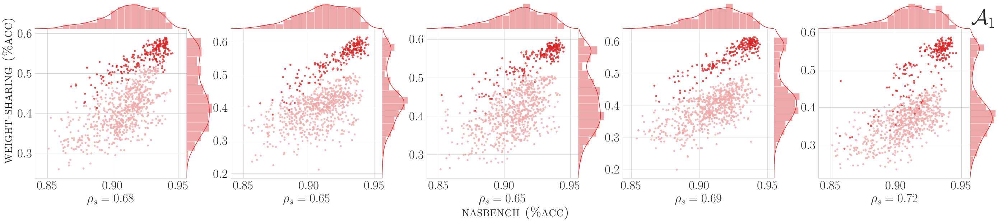

In [19]:
indexes = range(5)
h = lambda matrix, node: matrix[0, -1] * 2
_ = plot_corrs("baseline_ft_bn", indexes, search_spaces=["1"], size=[0.75 * 12 * len(indexes), 0.75 * 12], bias=h, wspace=0.75, limit=0.75, top_k=None)

### bias on a_4

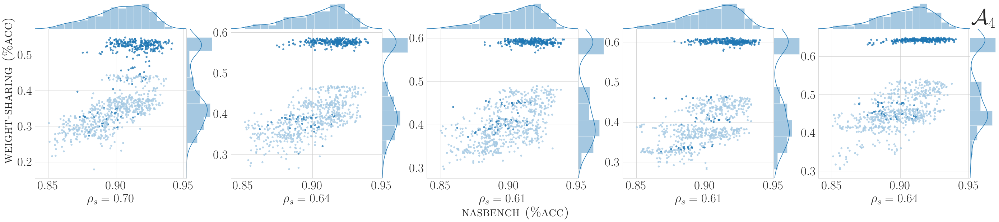

In [20]:
indexes = range(5)
h = lambda matrix, node: (node[0] == 2) * 2
_ = plot_corrs("baseline_ft_bn", indexes, search_spaces=["4"], size=[0.75 * 12 * len(indexes), 0.75 * 12], bias=h, wspace=0.75, limit=0.75, top_k=None)

## Visualizing Individual Regret Curves

In [21]:
def plot_individual_regrets(exp_name, runs, indexes, search_spaces=SEARCH_SPACES, seed=12345, ratio=4, 
                            best_regrets=best_regrets, avg_train_time=avg_train_time):

    # seed for nasbench queries
    np.random.seed(seed)
    
    # misc
    sns.set_style("whitegrid")
    matplotlib.rcParams.update({'font.size': 35})
    matplotlib.rcParams['mathtext.fontset'] = 'stix'
    matplotlib.rcParams['font.family'] = 'STIXGeneral'
    matplotlib.rc('text', usetex=True)
    
    # search spaces colors
    current_palette = sns.color_palette(n_colors=len(SEARCH_SPACES))
    cs = {sp: current_palette[i] for i, sp in enumerate(SEARCH_SPACES)}
    cs["bench_rs"] = "grey"
    data_path = os.path.join(RUNS_DIR + exp_name)
    save_path = "figures"
    
    times = {key: ratio * value for key, value in avg_train_time.items()}
    
    all_regrets_ws = {
        "4": [],
        "3": [],
        "2": [],
        "1": [],
        "full": [],
        "full_0": [],
        "full_1": [],
    }
    
    all_regrets_no_ws = {
        "4": [],
        "3": [],
        "2": [],
        "1": [],
        "full": [],
        "full_0": [],
        "full_1": [],
    }
    
    all_times_ws = {
        "4": [],
        "3": [],
        "2": [],
        "1": [],
        "full": [],
        "full_0": [],
        "full_1": [],
    }
    
    all_times_no_ws = {
        "4": [],
        "3": [],
        "2": [],
        "1": [],
        "full": [],
        "full_0": [],
        "full_1": [],
    }

    for n, sp in enumerate(search_spaces):
        
        # looking for the results of the evaluations
        path_results = glob.glob(os.path.join(data_path, "{}".format(sp), "*/eval_results.pkl"))
        
        plt.figure(figsize=(8, 8))
        plt.xscale("log")
        plt.yscale("log")
        
        # plotting text of search space
        splits = sp.split('_')
        l = splits[0]
        if l == "full":
            l = 0
        m = None
        if len(splits) > 1:
            m = "r" if int(splits[1]) else "\emptyset"
        space = "\mathcal{{A}}_{}^{}".format(l, m) if m is not None else "\mathcal{{A}}_{}".format(l)
        plt.text(0.75, 0.75, r'${}$'.format(space), transform=plt.gca().transAxes, fontsize=65)
        
        # cmaps
        cmap_no_ws = sns.light_palette(cs["bench_rs"], n_colors=8)
        cmap_ws = sns.light_palette(cs[sp], n_colors=8)

        for i in runs:
            
            # open results
            with open(path_results[i], "rb") as f:
                results = pickle.load(f)
            rand_ints = [np.random.randint(3) for _ in range(len(results))]
            
            # nasbench metrics of evaluated models
            metrics = [res["bench_metrics"] for res in results]
            # proxy accuracies of evaluated models
            losses = [res["proxy_metrics"]["final_validation_accuracy"] for res in results]
            
            # regrets and times without WS
            cum_arg_max = cumargmax([m[rand_ints[i]]["final_validation_accuracy"] for i, m in enumerate(metrics)])
            regrets_no_ws = 1 - np.array([np.mean([metrics[arg][i]["final_test_accuracy"] for i in range(3)]) for arg in cum_arg_max]) - best_regrets[sp]
            times_no_ws = np.cumsum([m[rand_ints[i]]["final_training_time"] for i, m in enumerate(metrics)])
                
            # regrets and times with WS
            arg_sort = np.argsort(losses)[::-1]
            cum_arg_max = [arg_sort[arg] for arg in cumargmax([metrics[arg][rand_ints[arg]]["final_validation_accuracy"] for arg in arg_sort])]
            regrets_ws = 1 - np.array([np.mean([metrics[arg][i]["final_test_accuracy"] for i in range(3)]) for arg in cum_arg_max]) - best_regrets[sp]
            times_ws = np.cumsum([metrics[arg][rand_ints[arg]]["final_training_time"] for arg in arg_sort]) + times[sp]
        
            plt.plot(times_no_ws, regrets_no_ws, c=cmap_no_ws[-i], linewidth=5, alpha=0.75)
            plt.plot(times_ws, regrets_ws, c=cmap_ws[-i], linewidth=5, alpha=0.75)
            
            all_regrets_ws[sp].append(regrets_ws)
            all_regrets_no_ws[sp].append(regrets_no_ws)
            all_times_ws[sp].append(times_ws)
            all_times_no_ws[sp].append(times_no_ws)

        plt.ylabel(r"\textsc{{{}}}".format("test regret"))
        plt.xlabel(r"\textsc{{{}}}".format("time (s)"))
        
        # save and display
        plt.savefig(os.path.join(save_path, "regrets_ind_" + sp + "_" + exp_name + ".png"),  bbox_inches = 'tight')
        plt.show()
    
    # return all the times and regrets to compute more stuff
    return all_regrets_no_ws, all_regrets_ws, all_times_no_ws, all_times_ws

def plot_avg_regrets(exp_name, all_regrets_ws, all_regrets_no_ws, all_times_ws, all_times_no_ws,
                     search_spaces=SEARCH_SPACES, tops=[1, 10, 100], n_runs=5):
    
    # colors for search spaces
    current_palette = sns.color_palette(n_colors=len(SEARCH_SPACES))
    cs = {sp: current_palette[i] for i, sp in enumerate(SEARCH_SPACES)}
    cs["bench"] = "grey"
    
    # misc
    sns.set_style("whitegrid")
    import matplotlib
    matplotlib.rcParams.update({'font.size': 35})
    matplotlib.rcParams['mathtext.fontset'] = 'stix'
    matplotlib.rcParams['font.family'] = 'STIXGeneral'
    matplotlib.rc('text', usetex=True)

    # stuff to be returned
    regrets = {sp: {top: [] for top in tops} for sp in search_spaces}

    for _, sp in enumerate(search_spaces):
        
        # cmaps
        cmap_ws = sns.light_palette(cs[sp], n_colors=8)
        cmap_no_ws = sns.light_palette(cs["bench"], n_colors=8)

        fig = plt.figure(figsize=(10, 10), constrained_layout=False)
        gs = fig.add_gridspec(3, 3, wspace=0, hspace=0)

        axplt = fig.add_subplot(gs[1:, :])

        axplt.set_yscale("log")
        axplt.set_xscale("log")
        axplt.set_ylabel(r"\textsc{{{}}}".format("test regret"))
        axplt.set_xlabel(r"\textsc{{{}}}".format("time(s)"))

        tmp_regrets_ws = all_regrets_ws[sp]
        tmp_regrets_no_ws = all_regrets_no_ws[sp]
        tmp_times_ws = all_times_ws[sp]
        tmp_times_no_ws = all_times_no_ws[sp]

        # curve and variance no ws
        mean_regret_no_ws = np.mean([np.array(t) for t in tmp_regrets_no_ws], axis=0)
        std_regret_no_ws = np.std([np.array(t) for t in tmp_regrets_no_ws], axis=0)
        mean_time_no_ws = np.mean([np.array(t) for t in tmp_times_no_ws], axis=0)
        axplt.plot(mean_time_no_ws, mean_regret_no_ws, c=cmap_no_ws[-1], alpha=1, linewidth=5)
        axplt.fill_between(mean_time_no_ws, mean_regret_no_ws + 1.96 * std_regret_no_ws / np.sqrt(n_runs), 
                         mean_regret_no_ws - 1.96 * std_regret_no_ws / np.sqrt(n_runs), color=cmap_no_ws[-2], alpha=0.25)

        # curve and variance ws
        mean_regret_ws = np.mean([np.array(t) for t in tmp_regrets_ws], axis=0)
        std_regret_ws = np.std([np.array(t) for t in tmp_regrets_ws], axis=0)
        mean_time_ws = np.mean([np.array(t) for t in tmp_times_ws], axis=0)
        axplt.plot(mean_time_ws, mean_regret_ws, c=cmap_ws[-1], alpha=1, linewidth=5)
        axplt.fill_between(mean_time_ws, mean_regret_ws + 2 * std_regret_ws / np.sqrt(n_runs), 
                         mean_regret_ws - 2 * std_regret_ws / np.sqrt(n_runs), color=cmap_ws[-2], alpha=0.25)

        splits = sp.split('_')
        l = splits[0]
        if l == "full":
            l = 0
        m = None
        if len(splits) > 1:
            m = "r" if int(splits[1]) else "\emptyset"
        space = "\mathcal{{A}}_{}^{}".format(l, m) if m is not None else "\mathcal{{A}}_{}".format(l)
        plt.text(0.8, 0.75, r'${}$'.format(space), transform=plt.gca().transAxes, fontsize=65)

        # markers for zoom-ins
        markers = ["o", "^", "s"]
        axs = []
        wxmins = []
        wxmaxs = []
        wymins = []
        wymaxs = []
        
        # displaying each zoom-in
        for j, top in enumerate(tops):
            
            # computing top regret using ws and random search equivalent
            x_1 = [t[top-1] for t in tmp_regrets_ws]
            y_1 = [t[top-1] for t in tmp_times_ws]

            x2_1 = []
            y2_1 = []
            for n, t in enumerate(tmp_times_no_ws):

                for i in range(len(t)):
                    if t[i] >= y_1[n]:
                        x2_1.append(tmp_regrets_no_ws[n][i-1])
                        y2_1.append(tmp_times_no_ws[n][i-1])
                        break
            
            # sizes of the different zoom-in boxes
            wymin = np.min([x_1, x2_1]) * 0.75
            wymax = np.max([x_1, x2_1]) * 1.3
            wxmin = np.min([y_1, y2_1]) * 0.9
            wxmax = np.max([y_1, y2_1]) * 1.1
            wymins.append(wymin)
            wymaxs.append(wymax)
            wxmins.append(wxmin)
            wxmaxs.append(wxmax)
            
            # appending the individual regrets for later
            regrets[sp][top].append(x_1)
            regrets[sp][top].append(x2_1)
            
            # plotting stuff
            ax = fig.add_subplot(gs[0, j])

            # scatter plots in zoom-ins
            ax.scatter(y_1, x_1, c=[cmap_ws[-1]], s=150, marker="P", alpha=0.75)
            ax.scatter(y2_1, x2_1, c=[cmap_no_ws[-1]], s=150, marker="P", alpha=0.75)
            
            # error bars in zoom-ins
            ax.errorbar(x=np.mean(y_1), y=np.mean(x_1), xerr=None, yerr=np.std(x_1), c=cmap_ws[-1], alpha=0.75, 
                        elinewidth=4, capsize=10, capthick=3, marker=".", markersize=15, markeredgewidth=3)
            ax.errorbar(x=np.mean(y2_1), y=np.mean(x2_1), xerr=None, yerr=np.std(x2_1), c=cmap_no_ws[-1], alpha=0.75, 
                        elinewidth=4, capsize=10, capthick=3, marker=".", markersize=15, markeredgewidth=3)

            ax.plot(mean_time_no_ws, mean_regret_no_ws, c=cmap_no_ws[-1], alpha=0.15, linewidth=5,)
            ax.plot(mean_time_ws, mean_regret_ws, c=cmap_ws[-1], alpha=0.15, linewidth=5)
            
            # removing ticks and setting limits
            ax.set_xticks([], [])
            ax.set_yticks([], [])
            ax.set_xticklabels([])
            ax.set_yticklabels([])
            ax.set_xlim(wxmin, wxmax)
            ax.set_ylim(wymin, wymax)
            
            # legend and small symbol
            ax.scatter(0.1, 0.885, marker=markers[j], transform=ax.transAxes, s=350, c="k", zorder=10, alpha=0.75)
            ax.text(0.2, 0.825, r"\textsc{{{}}}".format("top-${}$".format(top)), transform=ax.transAxes, fontsize=35)
            axs.append(ax)
        
        # boxes in larger plots
        for n, (wxmin, wxmax, wymin, wymax) in enumerate(zip(wxmins, wxmaxs, wymins, wymaxs)):
            rect = patches.Rectangle((wxmin, wymin), (wxmax - wxmin), (wymax - wymin), color="k", fill=False, linewidth=2, zorder=5, alpha=0.6)
            axplt.add_patch(rect)
        
        # symbols in larger plots
        axplt.autoscale(True)
        xmin, xmax = axplt.get_xlim()
        ymin, ymax = axplt.get_ylim()
        for n, (wxmin, wxmax, wymin, wymax) in enumerate(zip(wxmins, wxmaxs, wymins, wymaxs)):
            axplt.scatter((np.log10(wxmin) - np.log10(xmin)) / (np.log10(xmax) - np.log10(xmin)) - 0.03, 
                          (np.log10(wymax) - np.log10(ymin)) / (np.log10(ymax) - np.log10(ymin)) - 0.008, 
                          marker=markers[n], transform=axplt.transAxes, s=350, c="k", zorder=10, alpha=0.75)
        
        # saving and displaying result
        plt.savefig(os.path.join("./figures", "regrets_" + sp + "_" + exp_name + ".png"),  bbox_inches = 'tight')
        plt.show()
        
    return regrets

def cumargmax(x):
    """
    Computes the cumulative argmax of the array i.e the array defined as [np.argmax(x[:i]) for i in range(len(x))]
    """
    maxv = x[0] 
    res = [0]
    for i in range(1, len(x)):
        
        if x[i] > maxv:
            maxv = x[i]
            res.append(i)
        else:
            res.append(res[-1])
    return res

def print_tests_results(regrets):
    """
    Prints the results and p-values of the Wilcoxon tests
    """
    for sp, v1 in regrets.items():
        print("Search Space: {}\n".format(sp))
        for top, v2 in v1.items():
            print("Top-{}".format(top))
            print("Two-sided", scipy.stats.wilcoxon(v2[0], v2[1], alternative="two-sided"))
            print("Greater", scipy.stats.wilcoxon(v2[0], v2[1], alternative="greater"))
            print("Smaller", scipy.stats.wilcoxon(v2[0], v2[1], alternative="less"))
        print("\n")

### no-ft

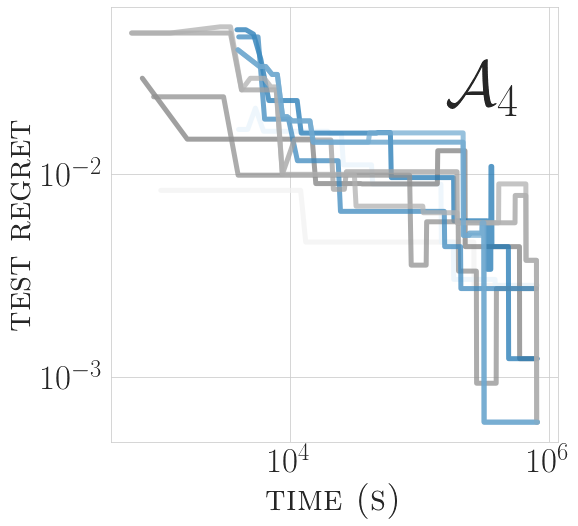

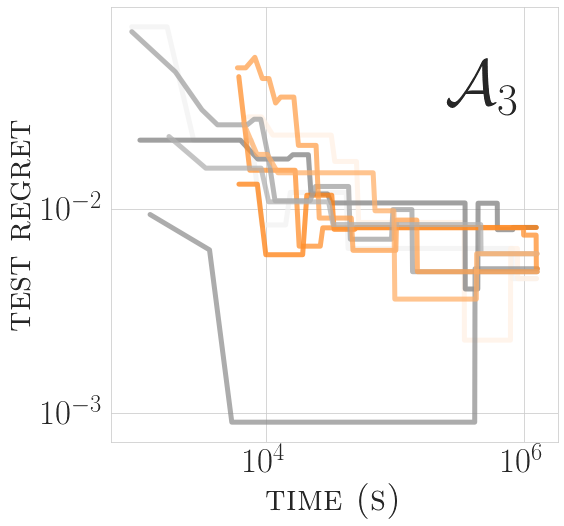

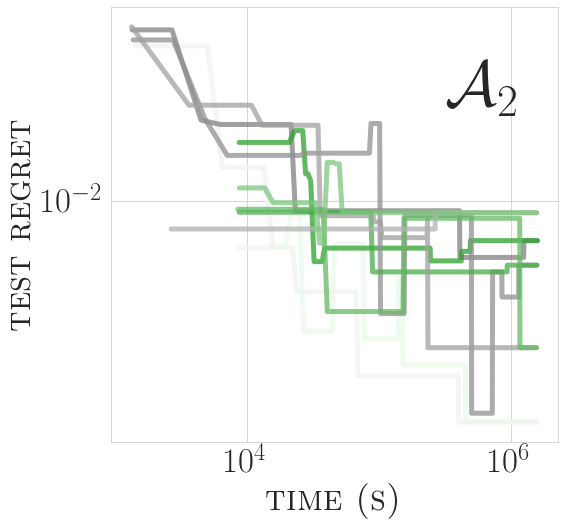

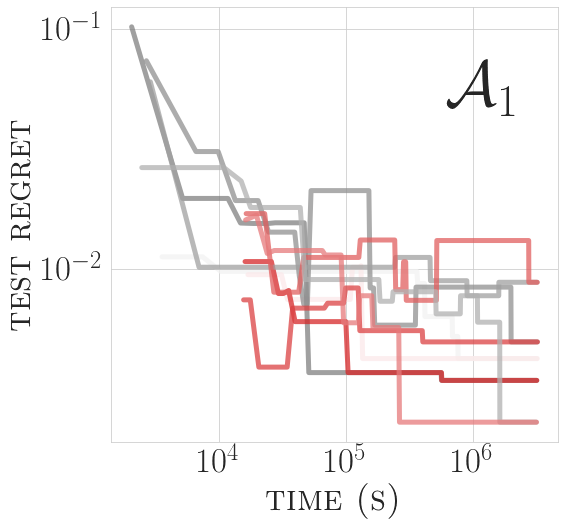

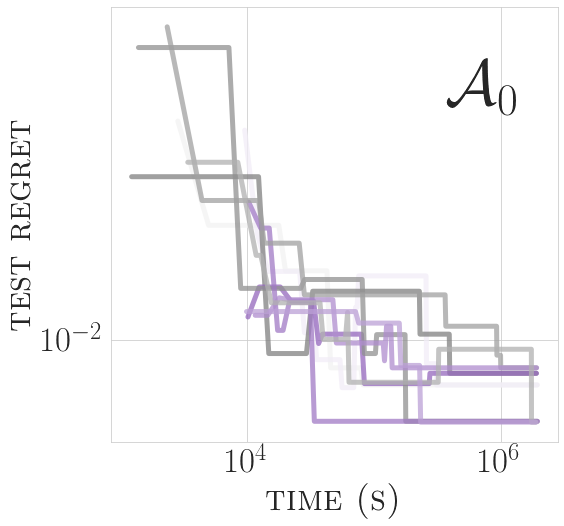

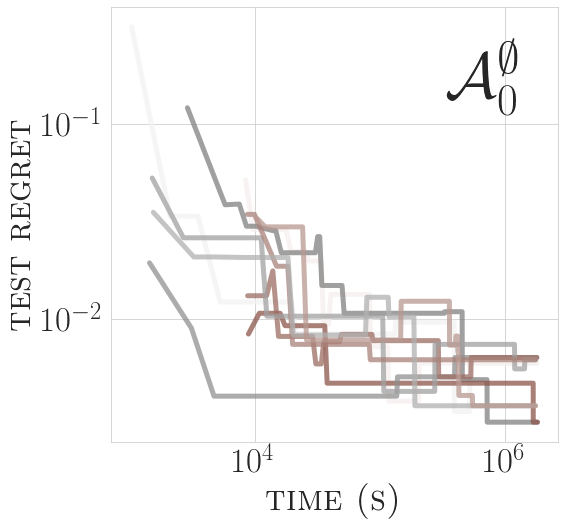

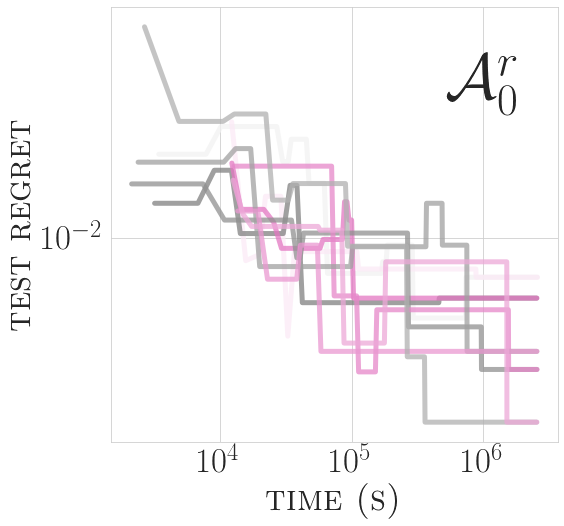

In [22]:
runs = range(5)
indexes = range(1000)
all_regrets_no_ws, all_regrets_ws, all_times_no_ws, all_times_ws = plot_individual_regrets("baseline_no_ft", runs, indexes, ratio=4)

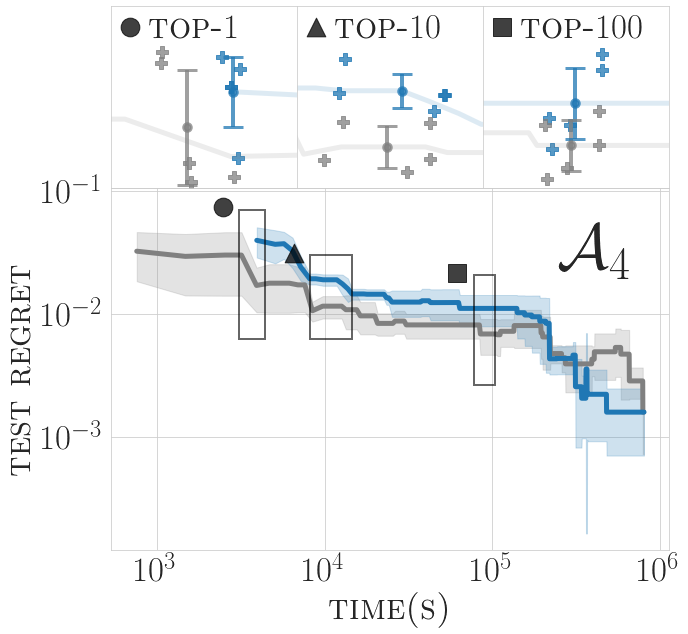

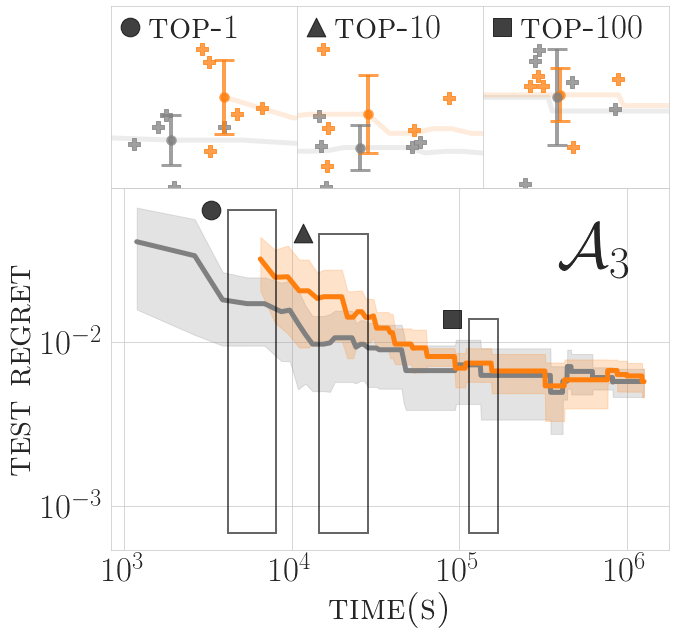

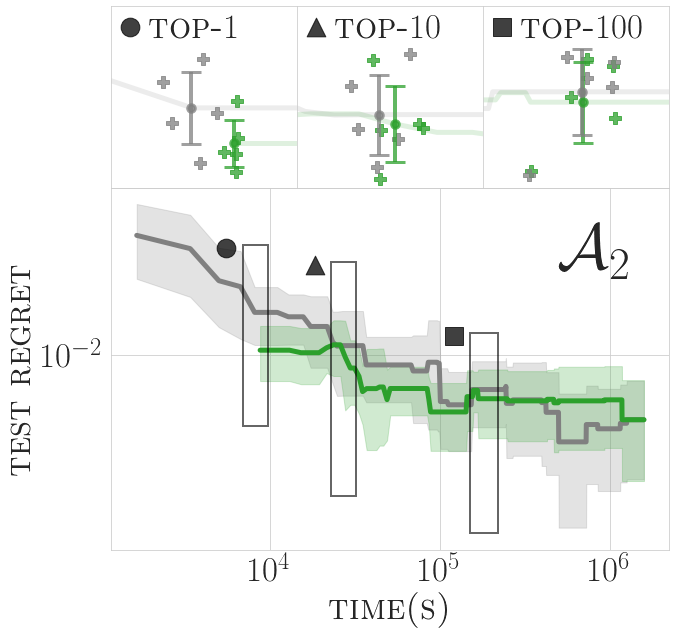

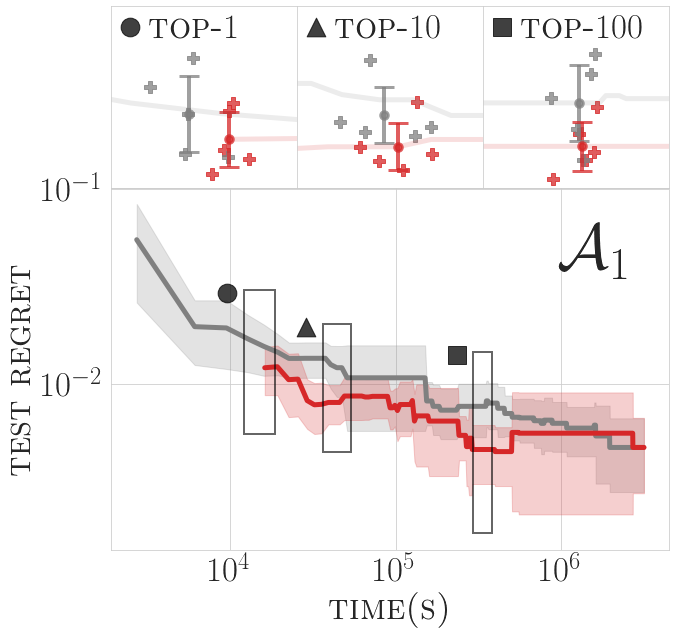

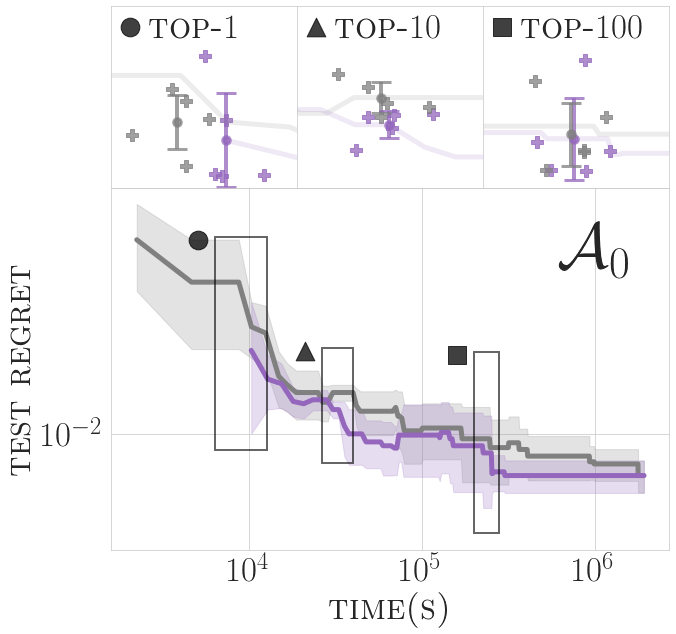

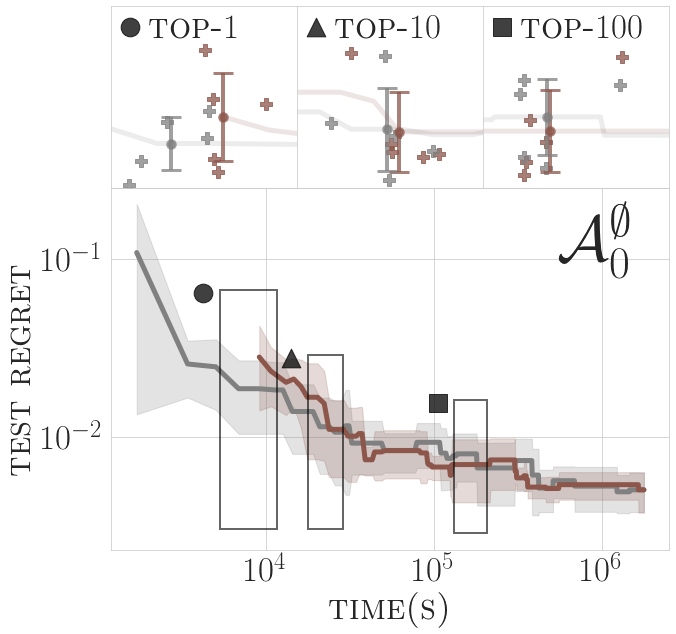

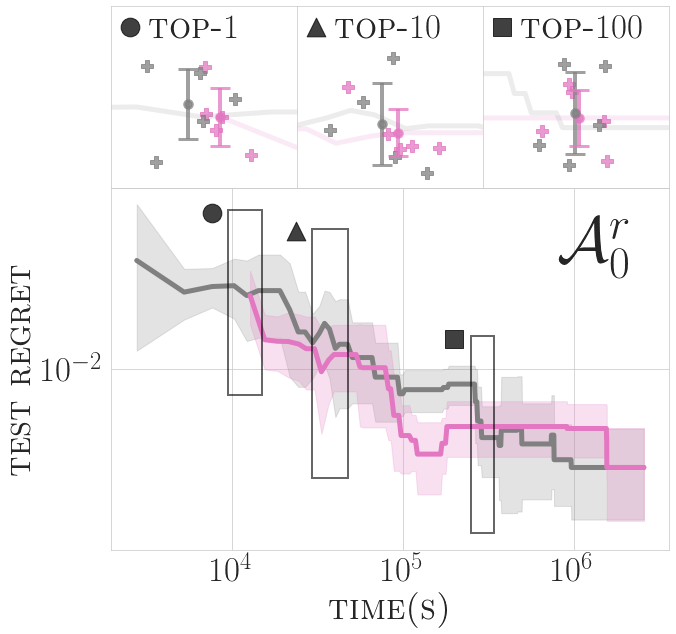

In [23]:
regrets = plot_avg_regrets("baseline_no_ft", all_regrets_ws, all_regrets_no_ws, all_times_ws, all_times_no_ws)

In [24]:
print_tests_results(regrets)

Search Space: 4

Top-1
Two-sided WilcoxonResult(statistic=5.0, pvalue=0.5001842570707944)
Greater WilcoxonResult(statistic=10.0, pvalue=0.2500921285353972)
Smaller WilcoxonResult(statistic=10.0, pvalue=0.7499078714646028)
Top-10
Two-sided WilcoxonResult(statistic=0.0, pvalue=0.043114446783075355)
Greater WilcoxonResult(statistic=15.0, pvalue=0.021557223391537678)
Smaller WilcoxonResult(statistic=15.0, pvalue=0.9784427766084624)
Top-100
Two-sided WilcoxonResult(statistic=0.0, pvalue=0.043114446783075355)
Greater WilcoxonResult(statistic=15.0, pvalue=0.021557223391537678)
Smaller WilcoxonResult(statistic=15.0, pvalue=0.9784427766084624)


Search Space: 3

Top-1
Two-sided WilcoxonResult(statistic=2.0, pvalue=0.13801073756865956)
Greater WilcoxonResult(statistic=13.0, pvalue=0.06900536878432978)
Smaller WilcoxonResult(statistic=13.0, pvalue=0.9309946312156703)
Top-10
Two-sided WilcoxonResult(statistic=3.0, pvalue=0.22491588401596185)
Greater WilcoxonResult(statistic=12.0, pvalue=0.11245794

/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/morestats.py:2879: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


### bns-ft baseline

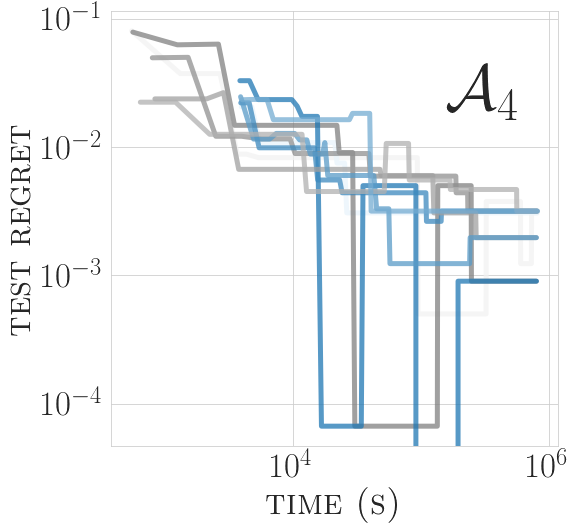

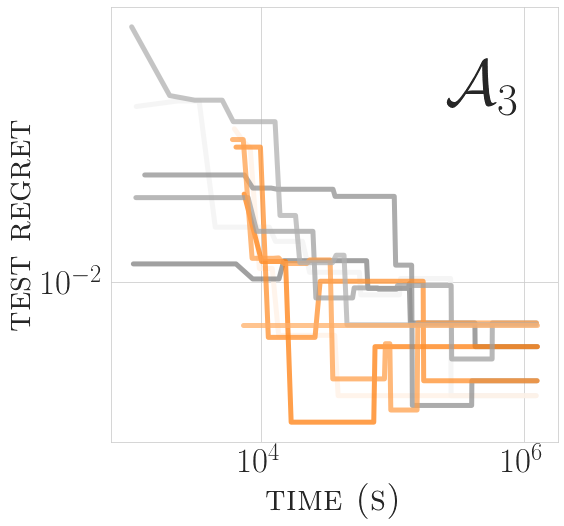

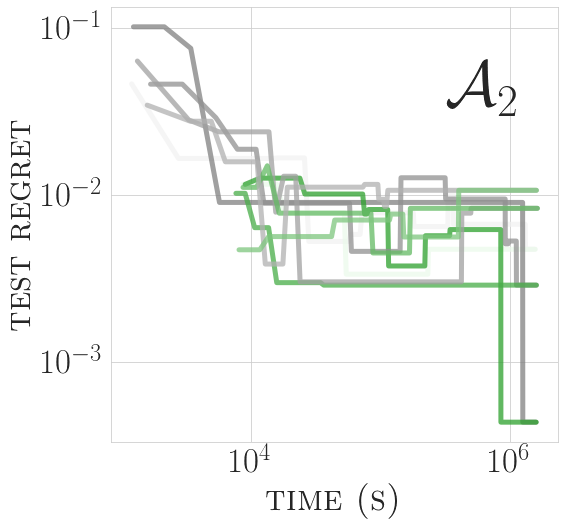

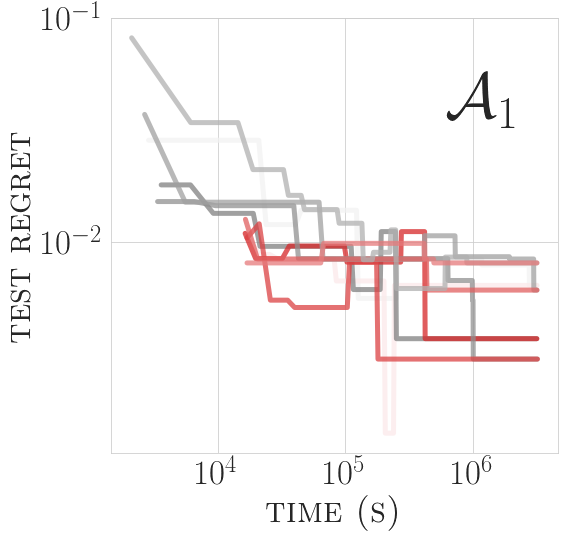

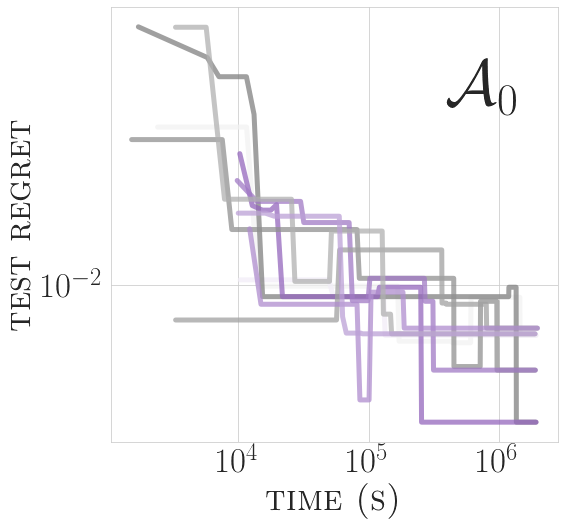

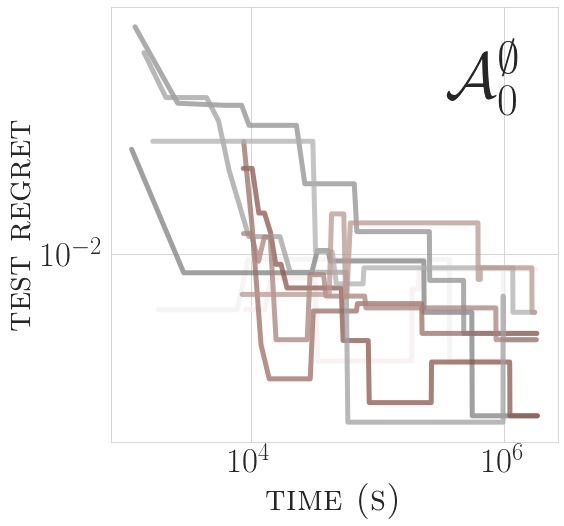

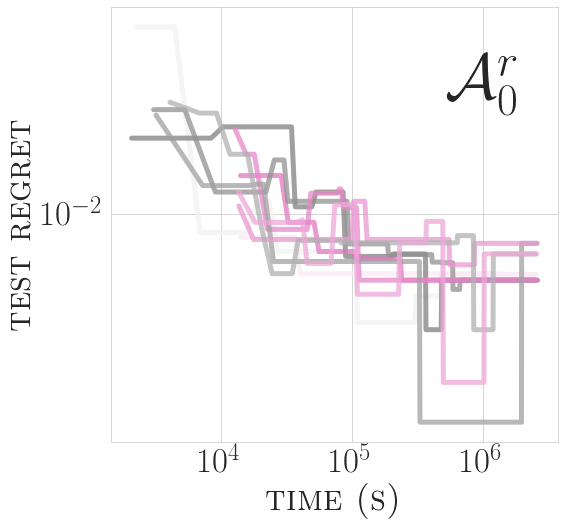

In [25]:
runs = range(5)
indexes = range(1000)
all_regrets_no_ws, all_regrets_ws, all_times_no_ws, all_times_ws = plot_individual_regrets("baseline_ft_bn", runs, indexes, ratio=4)

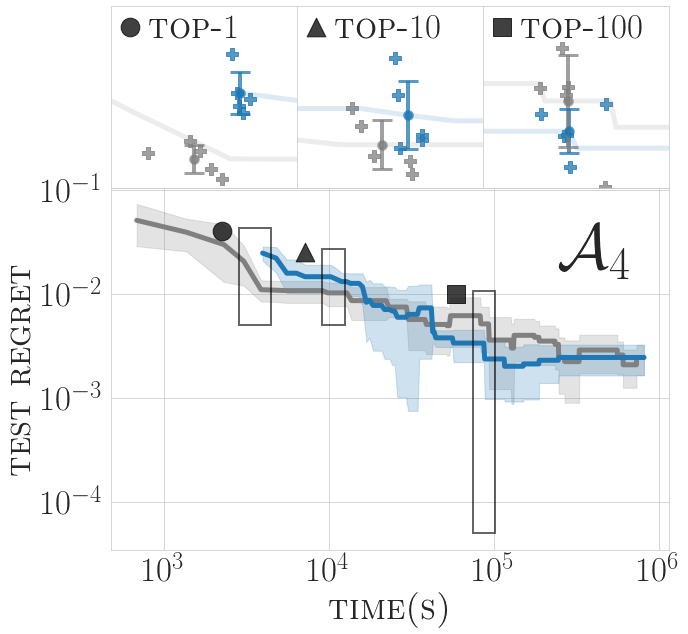

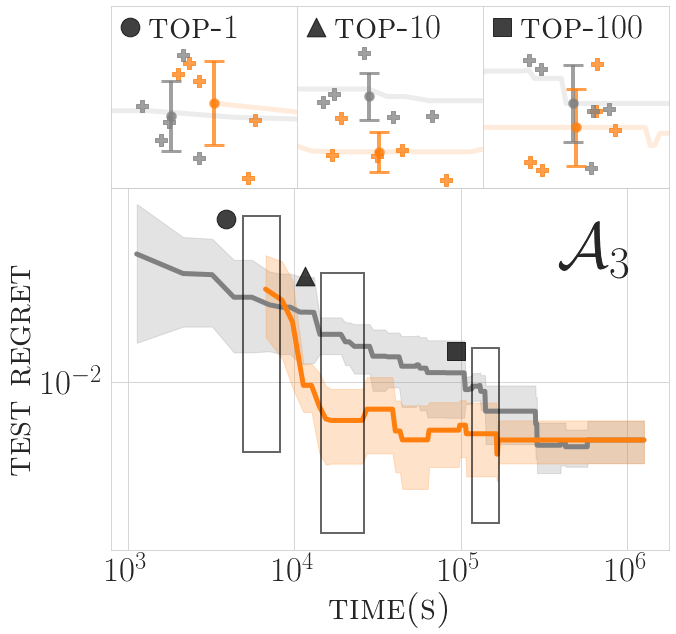

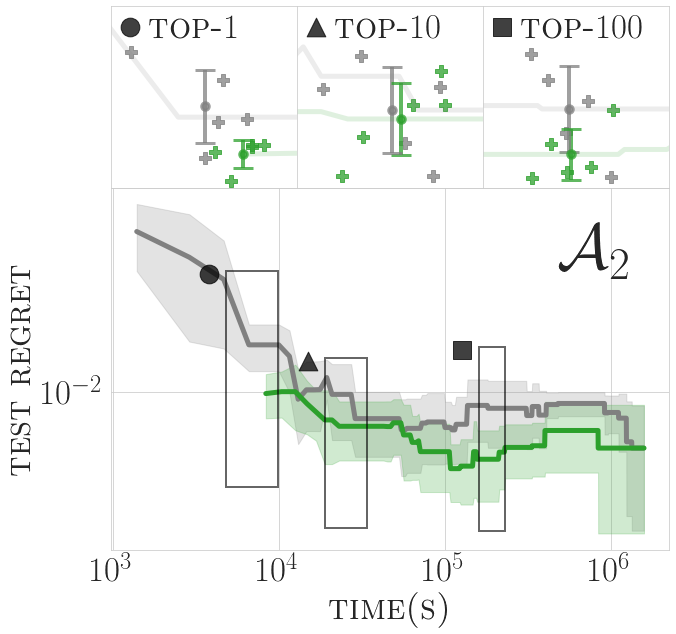

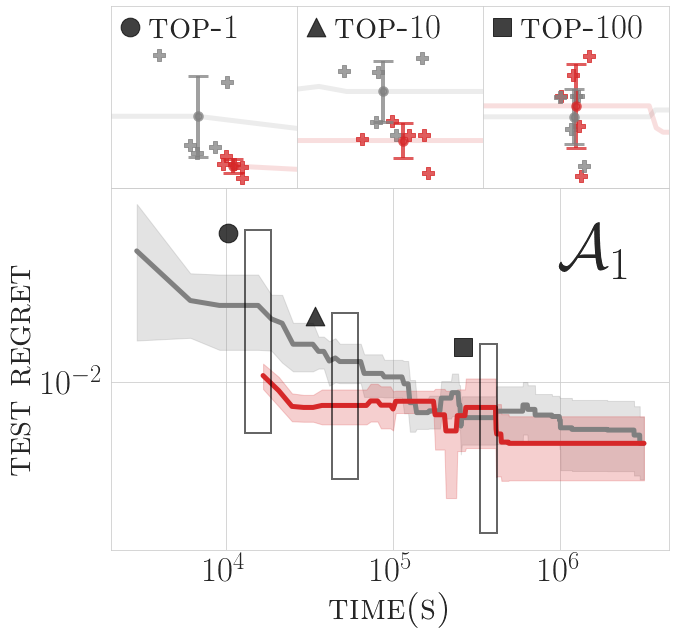

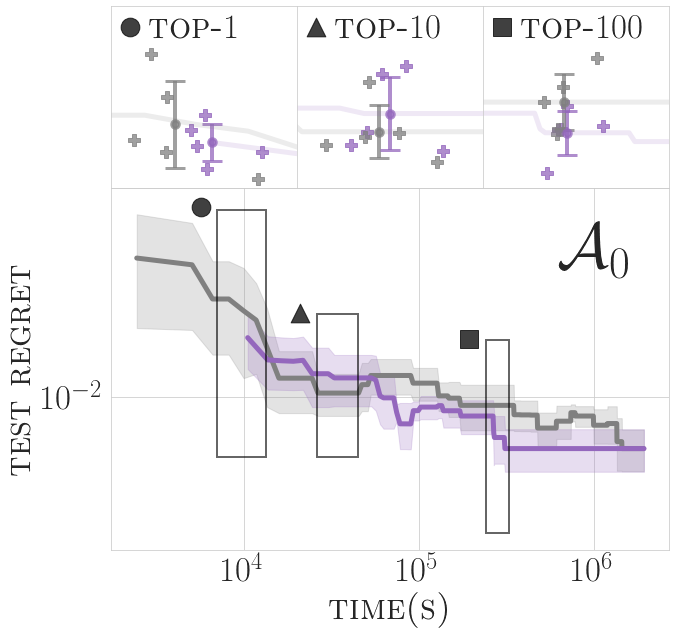

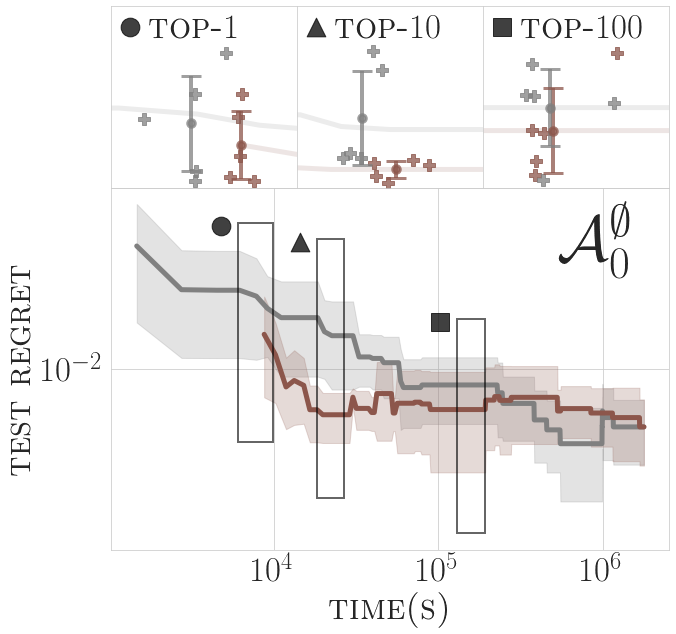

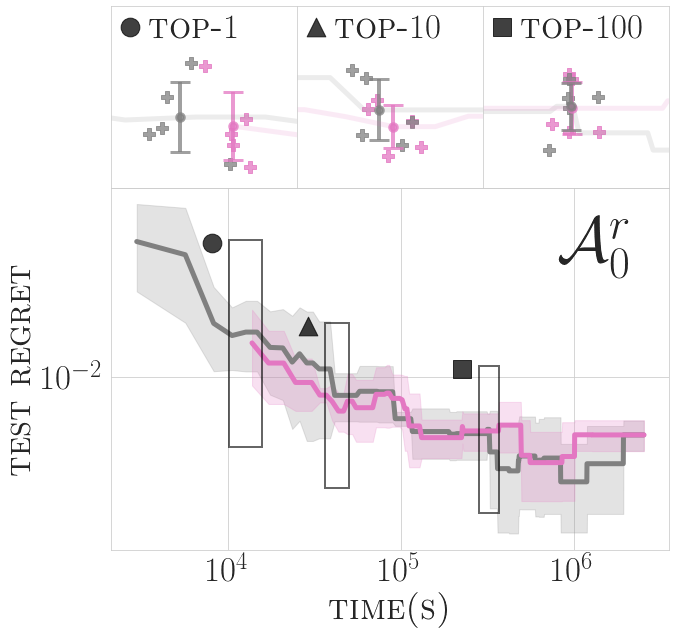

In [26]:
regrets = plot_avg_regrets("baseline_ft_bn", all_regrets_ws, all_regrets_no_ws, all_times_ws, all_times_no_ws)

In [27]:
print_tests_results(regrets)

Search Space: 4

Top-1
Two-sided WilcoxonResult(statistic=0.0, pvalue=0.043114446783075355)
Greater WilcoxonResult(statistic=15.0, pvalue=0.021557223391537678)
Smaller WilcoxonResult(statistic=15.0, pvalue=0.9784427766084624)
Top-10
Two-sided WilcoxonResult(statistic=0.0, pvalue=0.043114446783075355)
Greater WilcoxonResult(statistic=15.0, pvalue=0.021557223391537678)
Smaller WilcoxonResult(statistic=15.0, pvalue=0.9784427766084624)
Top-100
Two-sided WilcoxonResult(statistic=4.0, pvalue=0.34523107177184)
Greater WilcoxonResult(statistic=4.0, pvalue=0.82738446411408)
Smaller WilcoxonResult(statistic=4.0, pvalue=0.17261553588592)


Search Space: 3

Top-1
Two-sided WilcoxonResult(statistic=5.0, pvalue=0.5001842570707944)
Greater WilcoxonResult(statistic=10.0, pvalue=0.2500921285353972)
Smaller WilcoxonResult(statistic=10.0, pvalue=0.7499078714646028)
Top-10
Two-sided WilcoxonResult(statistic=0.0, pvalue=0.043114446783075355)
Greater WilcoxonResult(statistic=0.0, pvalue=0.9784427766084624)


/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/morestats.py:2879: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


### bns-ft pro-rata

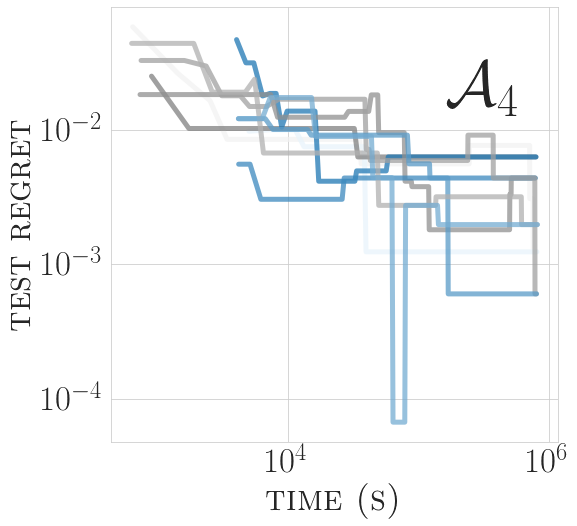

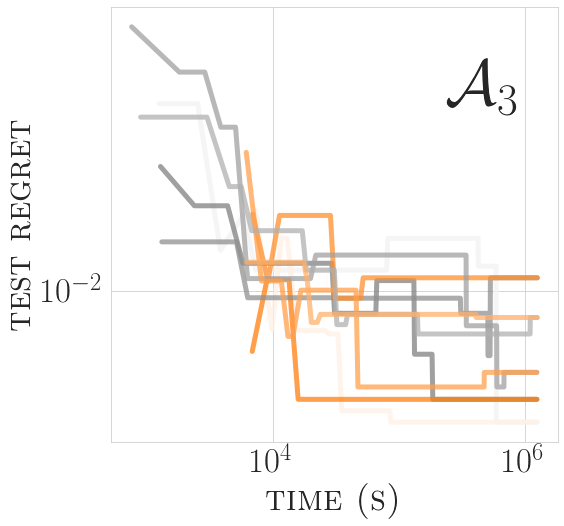

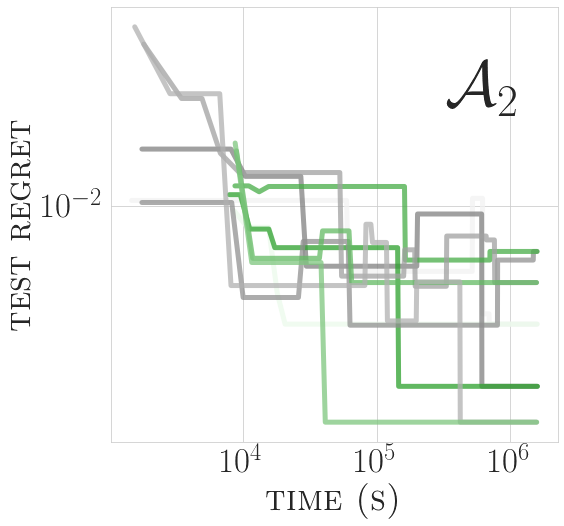

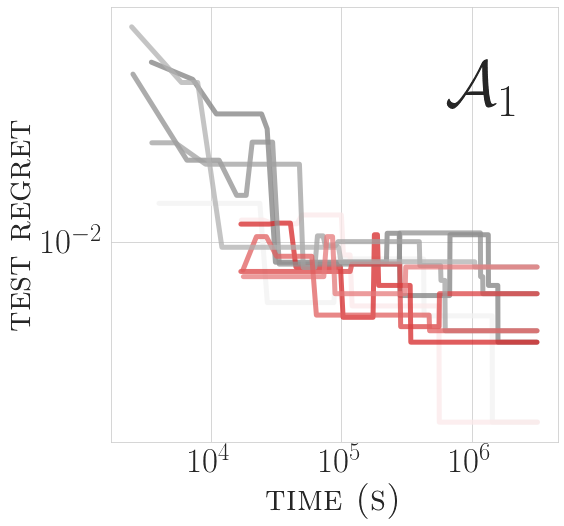

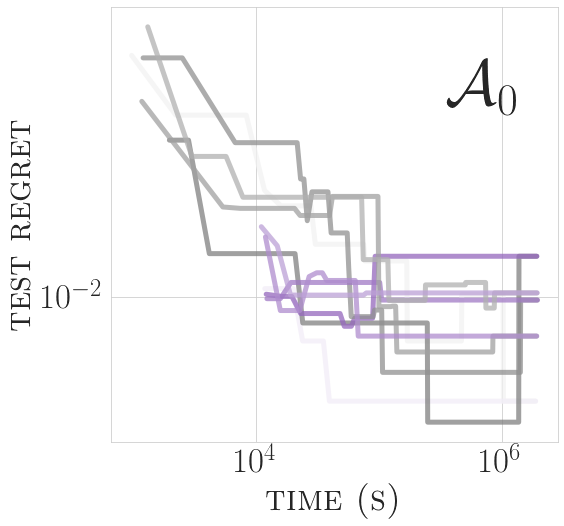

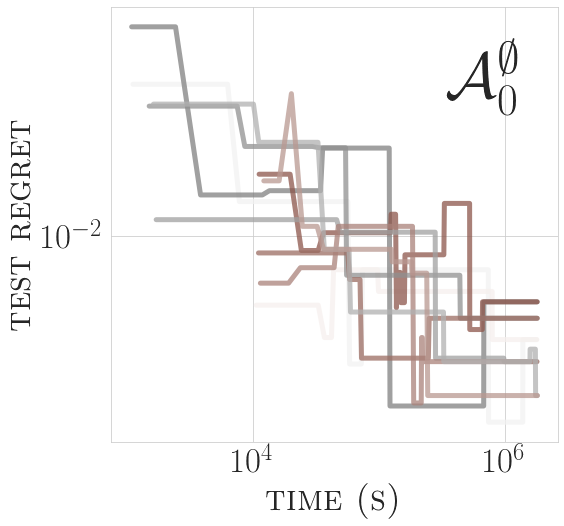

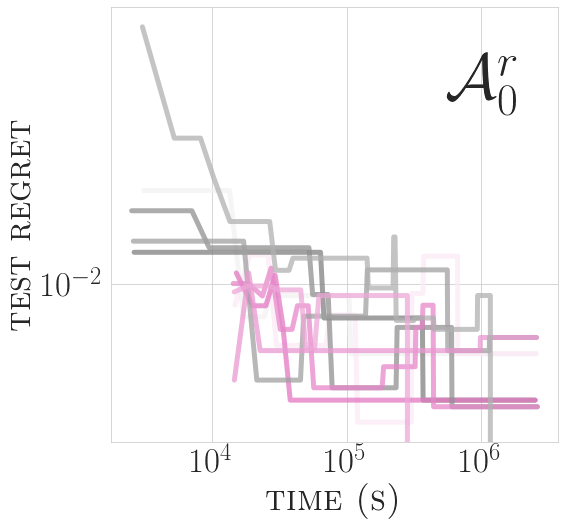

In [28]:
runs = range(5)
indexes = range(1000)
all_regrets_no_ws, all_regrets_ws, all_times_no_ws, all_times_ws = plot_individual_regrets("pro-rata_ft_bn", runs, indexes, ratio=4)

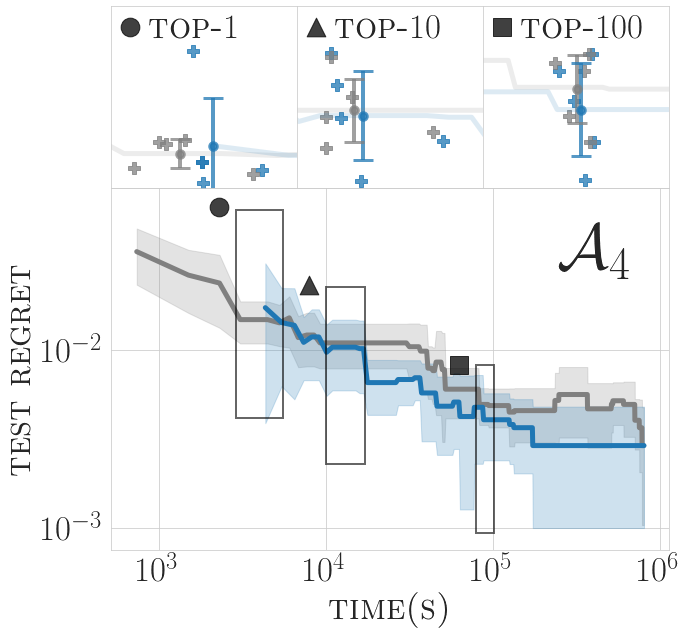

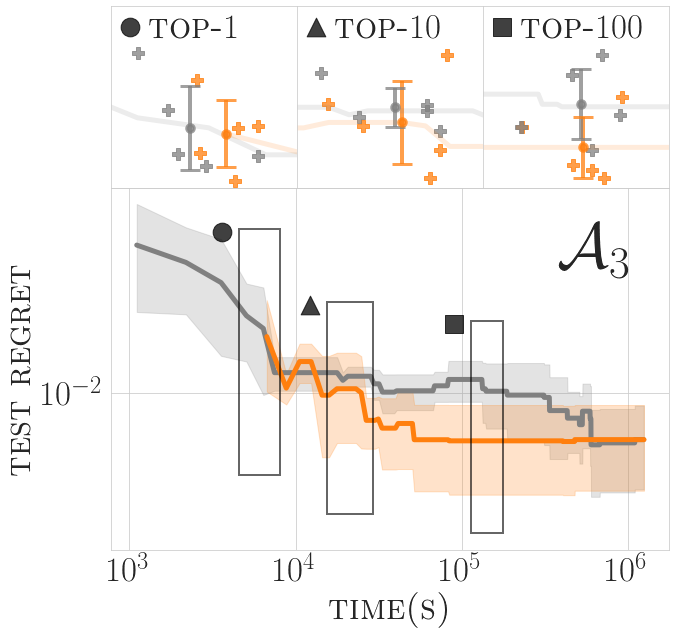

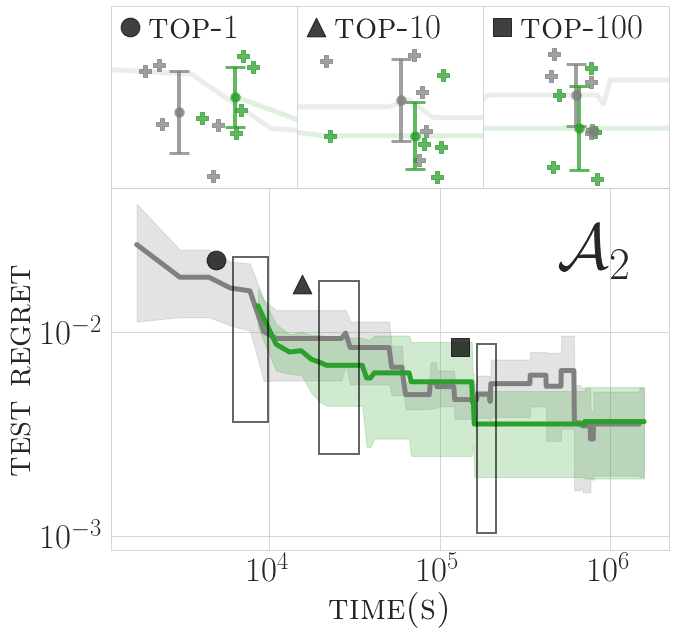

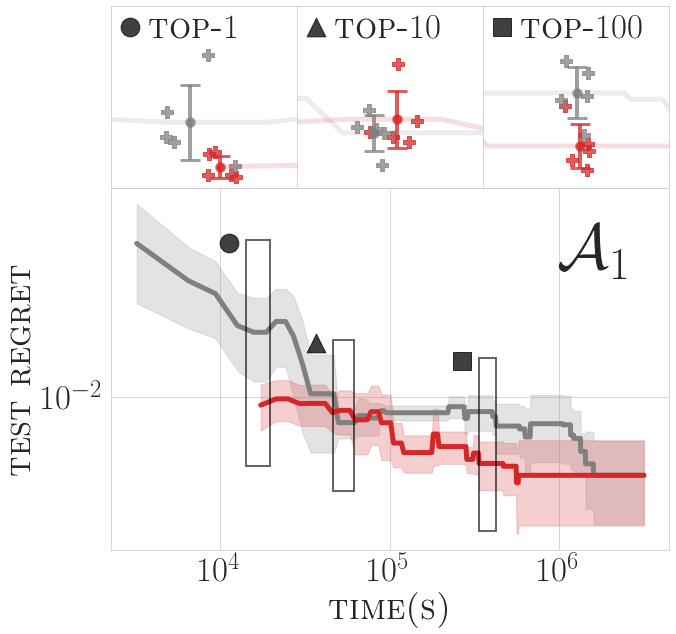

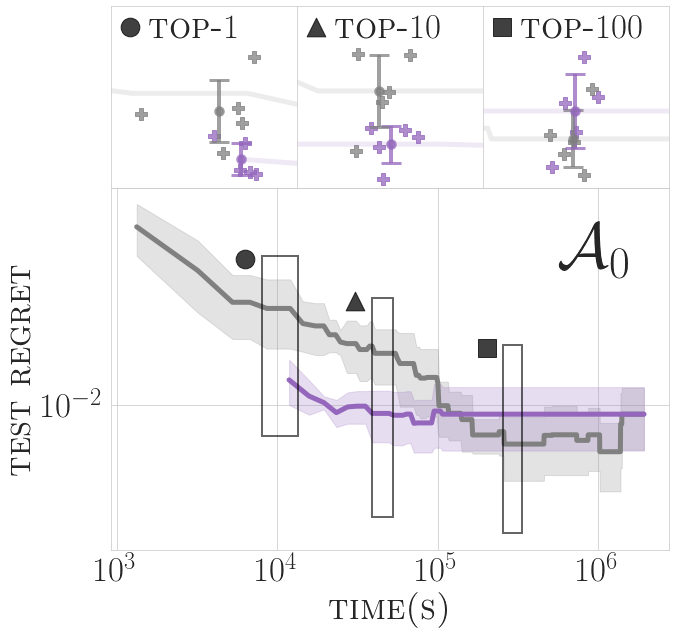

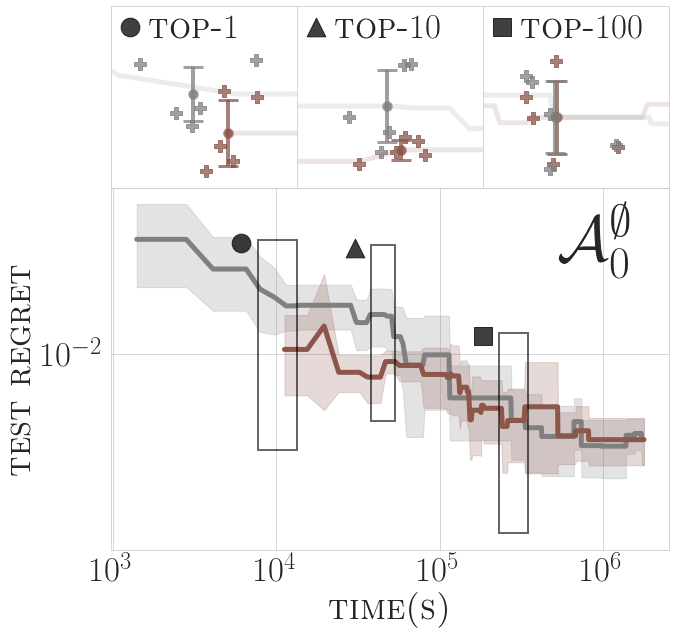

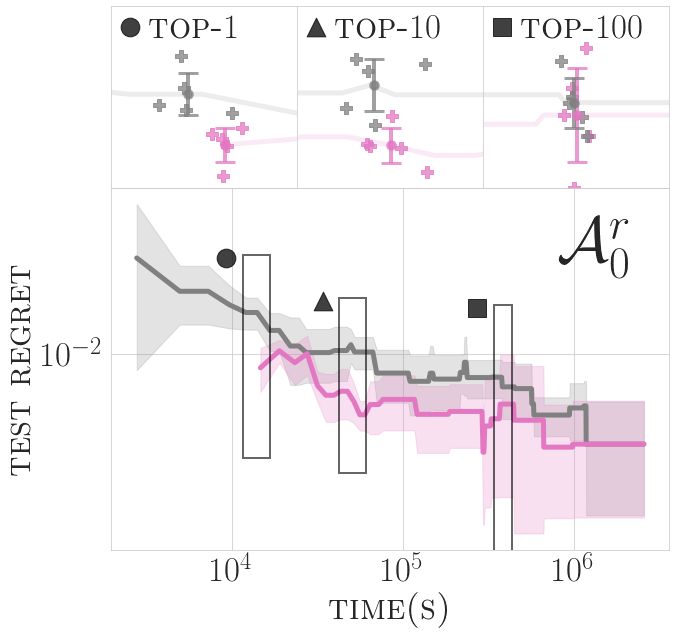

In [29]:
regrets = plot_avg_regrets("pro-rata_ft_bn", all_regrets_ws, all_regrets_no_ws, all_times_ws, all_times_no_ws)

In [30]:
print_tests_results(regrets)

Search Space: 4

Top-1
Two-sided WilcoxonResult(statistic=6.0, pvalue=0.6858304344516057)
Greater WilcoxonResult(statistic=6.0, pvalue=0.6570847827741971)
Smaller WilcoxonResult(statistic=6.0, pvalue=0.34291521722580287)
Top-10
Two-sided WilcoxonResult(statistic=7.0, pvalue=0.892738400944348)
Greater WilcoxonResult(statistic=7.0, pvalue=0.553630799527826)
Smaller WilcoxonResult(statistic=7.0, pvalue=0.446369200472174)
Top-100
Two-sided WilcoxonResult(statistic=2.0, pvalue=0.5929800980174267)
Greater WilcoxonResult(statistic=2.0, pvalue=0.7035099509912867)
Smaller WilcoxonResult(statistic=2.0, pvalue=0.29649004900871334)


Search Space: 3

Top-1
Two-sided WilcoxonResult(statistic=7.0, pvalue=0.892738400944348)
Greater WilcoxonResult(statistic=7.0, pvalue=0.553630799527826)
Smaller WilcoxonResult(statistic=7.0, pvalue=0.446369200472174)
Top-10
Two-sided WilcoxonResult(statistic=5.0, pvalue=0.5001842570707944)
Greater WilcoxonResult(statistic=5.0, pvalue=0.7499078714646028)
Smaller Wilcox

/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/morestats.py:2879: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


### bns-ft single path

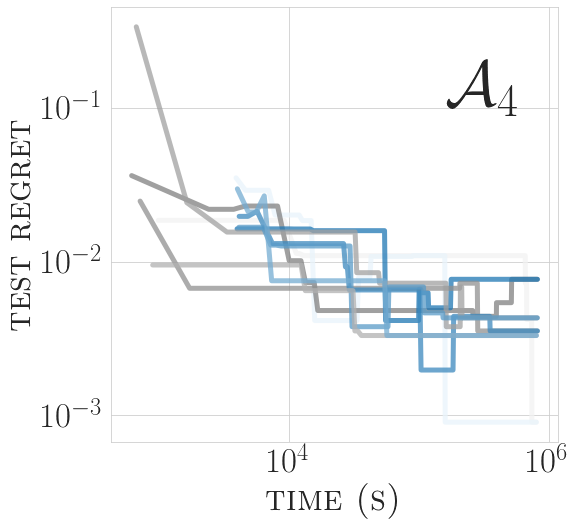

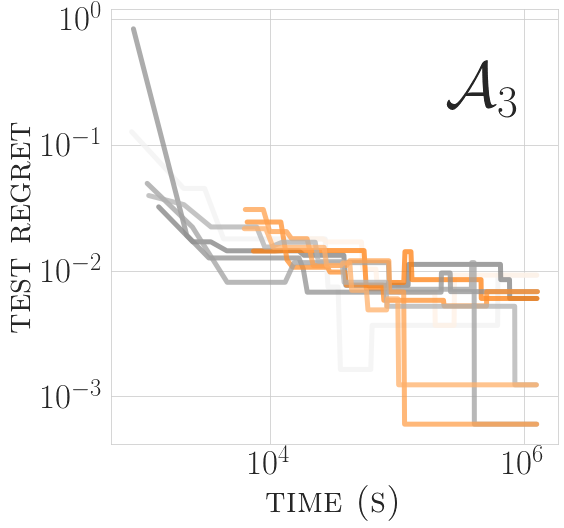

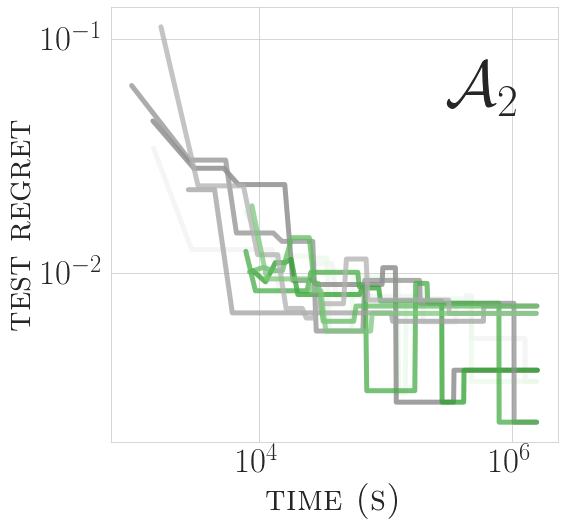

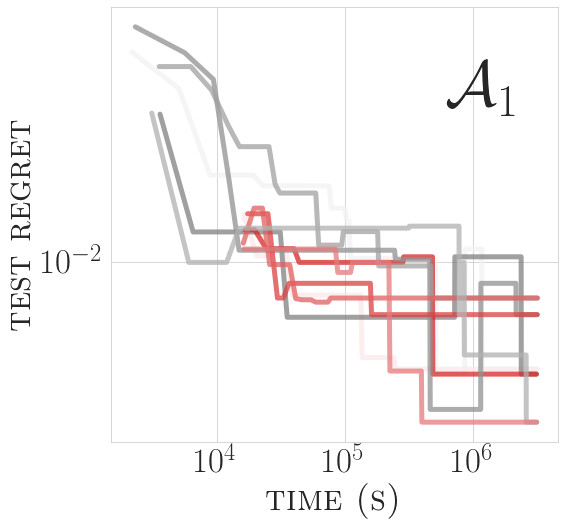

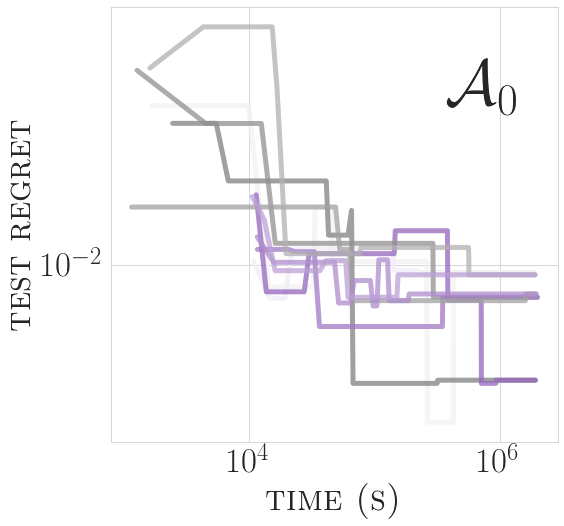

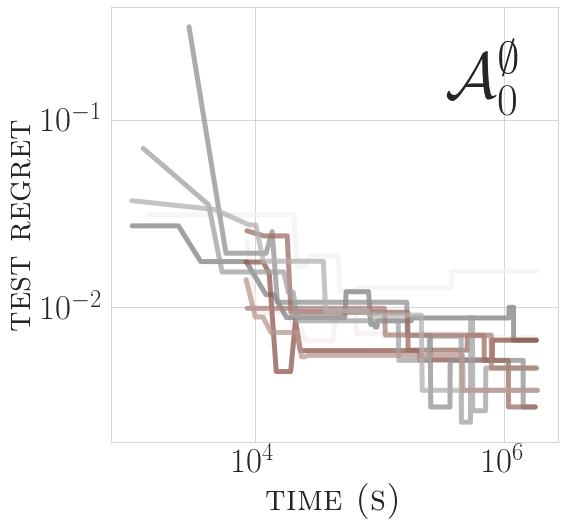

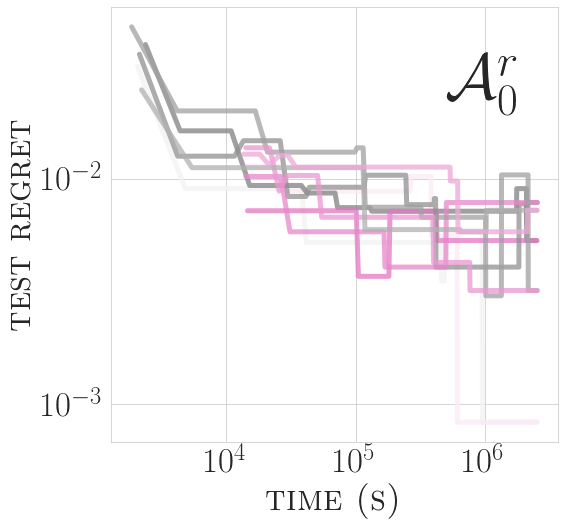

In [31]:
runs = range(5)
indexes = range(1000)
all_regrets_no_ws, all_regrets_ws, all_times_no_ws, all_times_ws = plot_individual_regrets("single-k_ft_bn", runs, indexes, ratio=4)

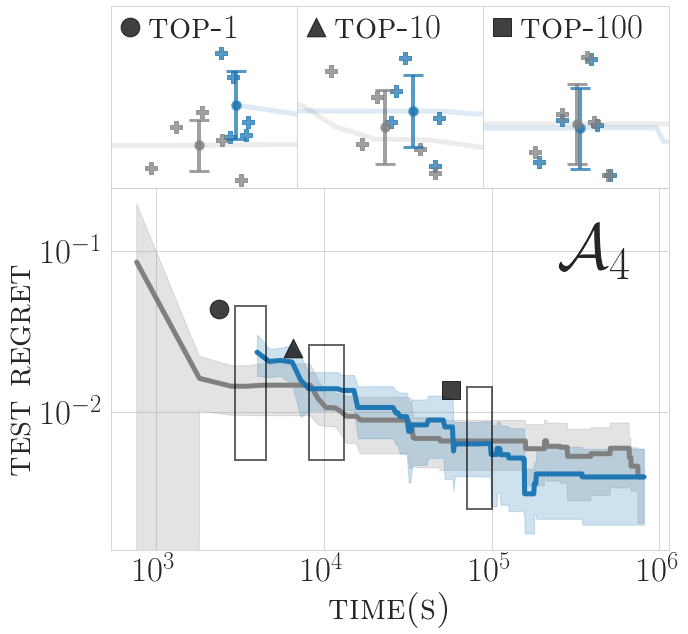

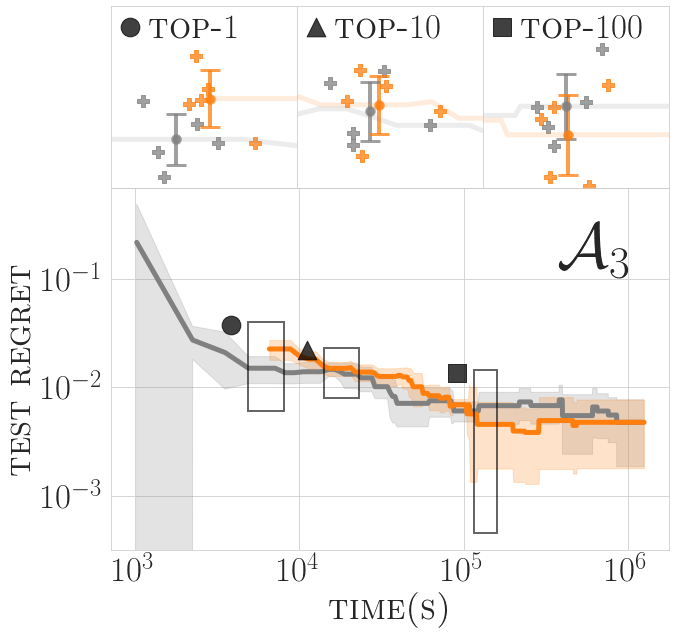

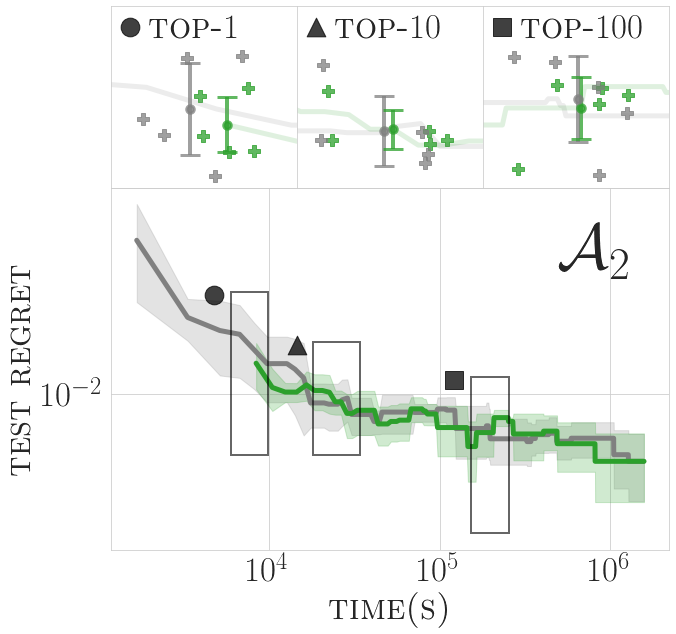

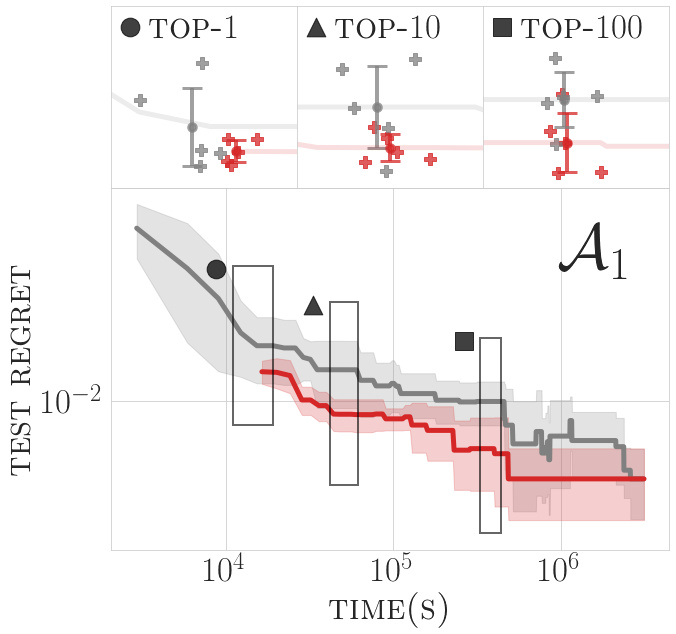

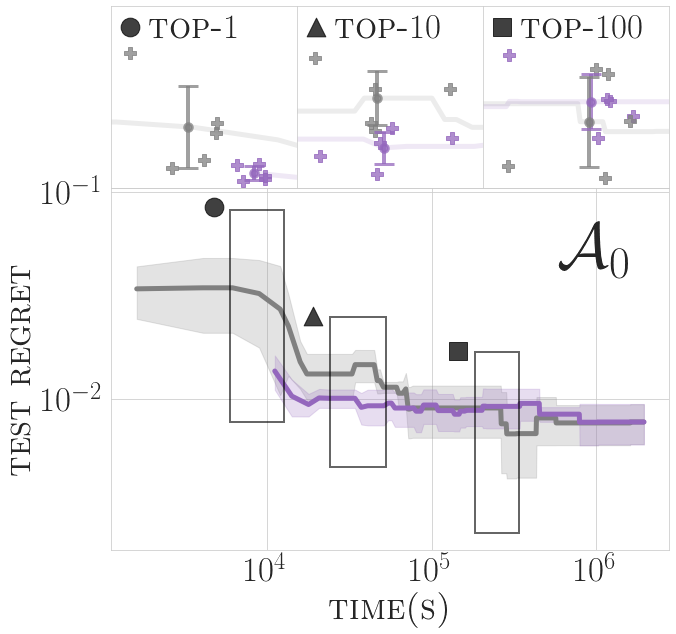

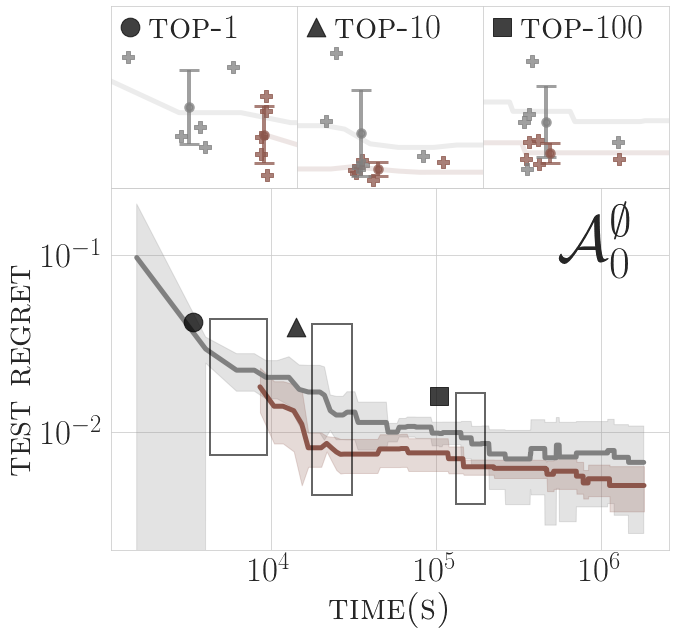

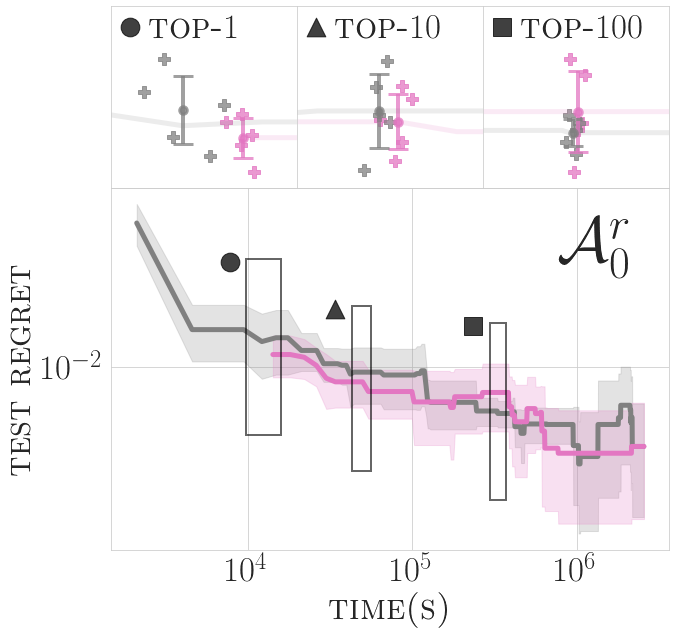

In [32]:
regrets = plot_avg_regrets("single-k_ft_bn", all_regrets_ws, all_regrets_no_ws, all_times_ws, all_times_no_ws)

In [33]:
print_tests_results(regrets)

Search Space: 4

Top-1
Two-sided WilcoxonResult(statistic=2.0, pvalue=0.13801073756865956)
Greater WilcoxonResult(statistic=13.0, pvalue=0.06900536878432978)
Smaller WilcoxonResult(statistic=13.0, pvalue=0.9309946312156703)
Top-10
Two-sided WilcoxonResult(statistic=5.0, pvalue=0.5001842570707944)
Greater WilcoxonResult(statistic=10.0, pvalue=0.2500921285353972)
Smaller WilcoxonResult(statistic=10.0, pvalue=0.7499078714646028)
Top-100
Two-sided WilcoxonResult(statistic=0.0, pvalue=0.06788915486182899)
Greater WilcoxonResult(statistic=0.0, pvalue=0.9660554225690855)
Smaller WilcoxonResult(statistic=0.0, pvalue=0.033944577430914495)


Search Space: 3

Top-1
Two-sided WilcoxonResult(statistic=3.0, pvalue=0.22491588401596185)
Greater WilcoxonResult(statistic=12.0, pvalue=0.11245794200798093)
Smaller WilcoxonResult(statistic=12.0, pvalue=0.887542057992019)
Top-10
Two-sided WilcoxonResult(statistic=6.0, pvalue=0.6858304344516057)
Greater WilcoxonResult(statistic=6.0, pvalue=0.6570847827741971

/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/morestats.py:2879: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


### bns-ft avg 3 

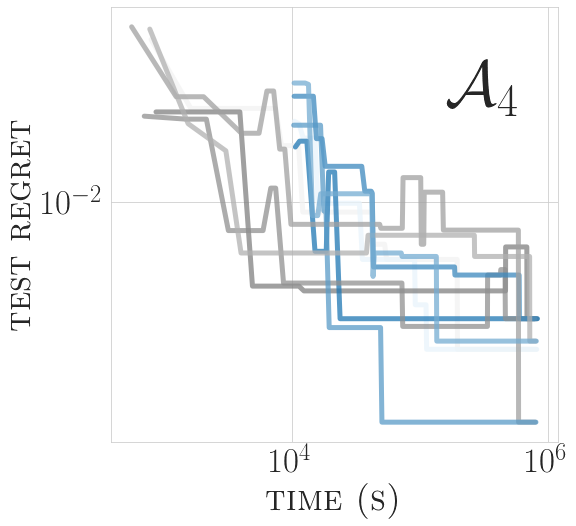

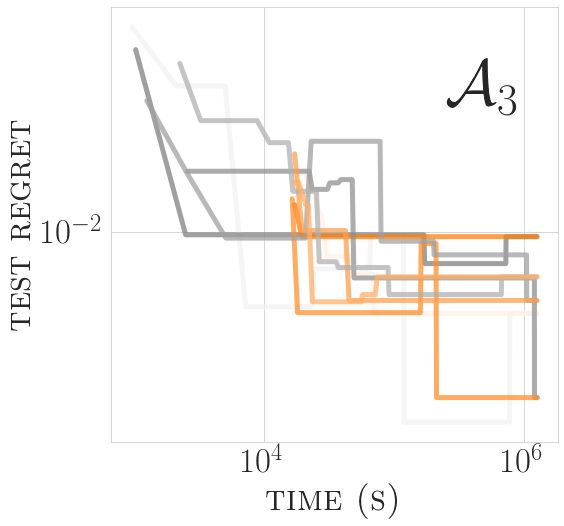

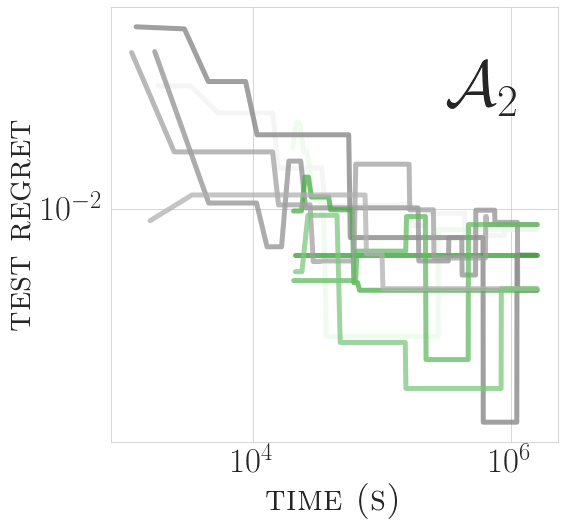

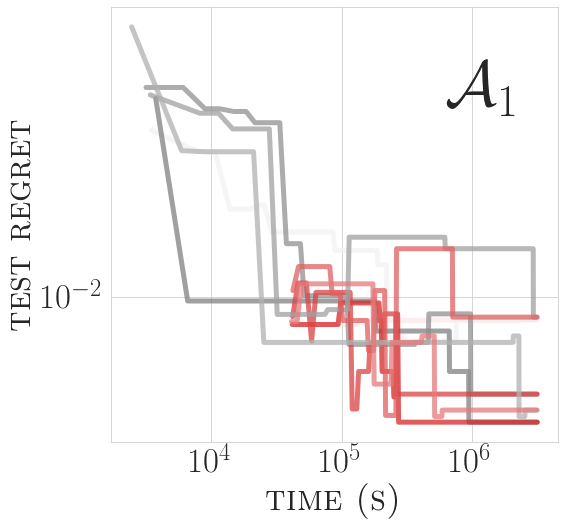

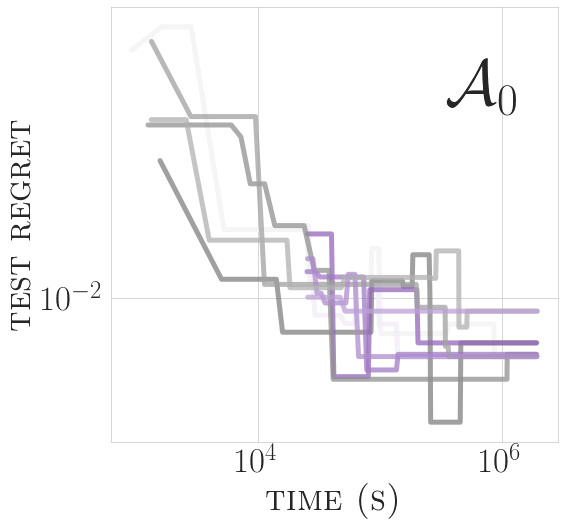

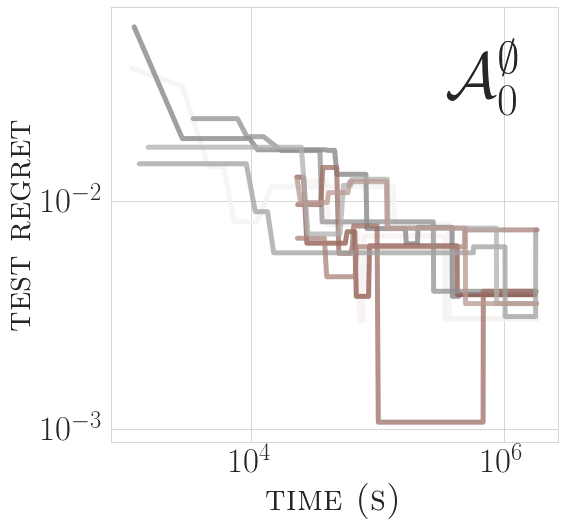

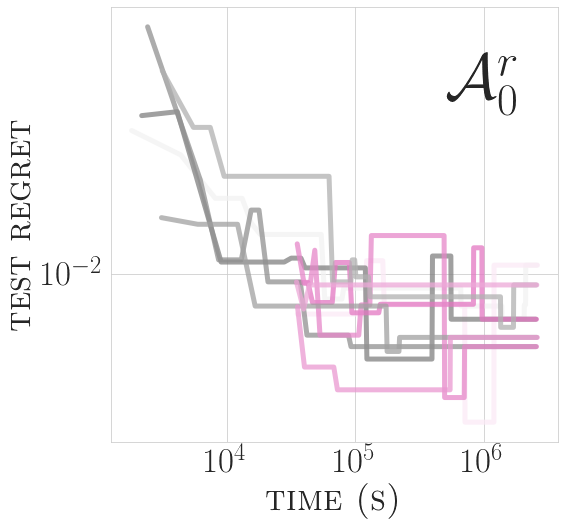

In [34]:
runs = range(5)
indexes = range(1000)
all_regrets_no_ws, all_regrets_ws, all_times_no_ws, all_times_ws = plot_individual_regrets("avg-3_ft_bn", runs, indexes, ratio=4 * 3)

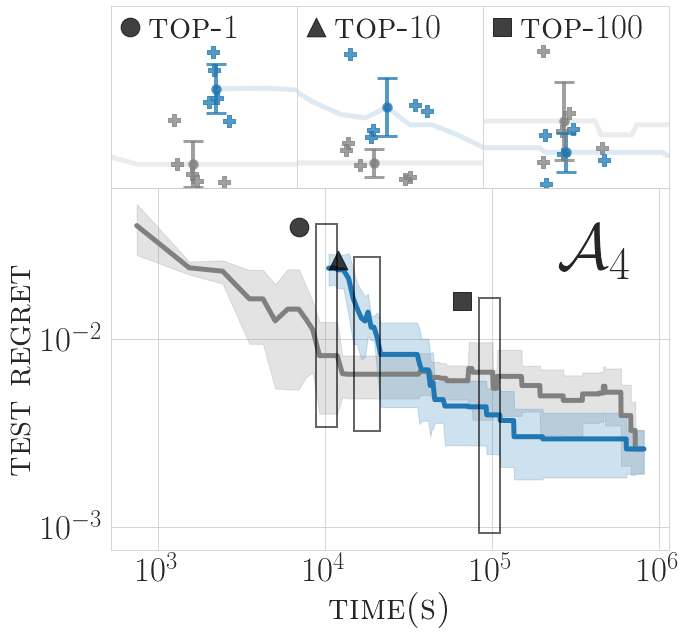

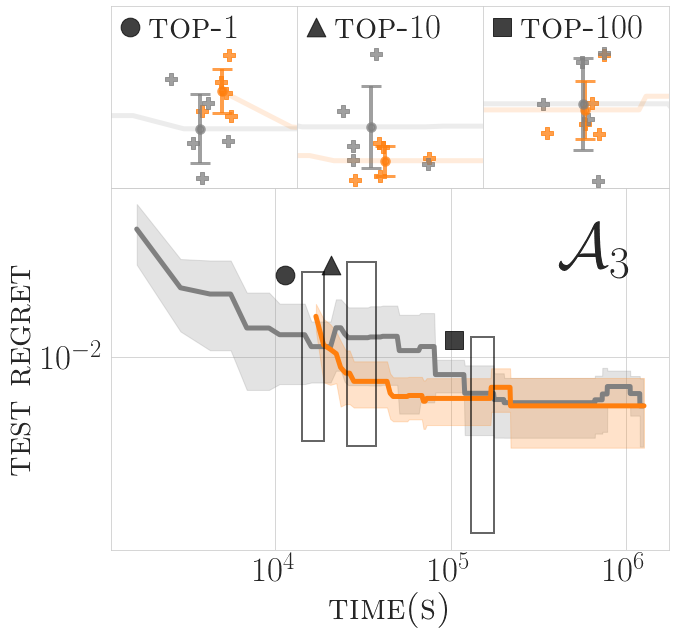

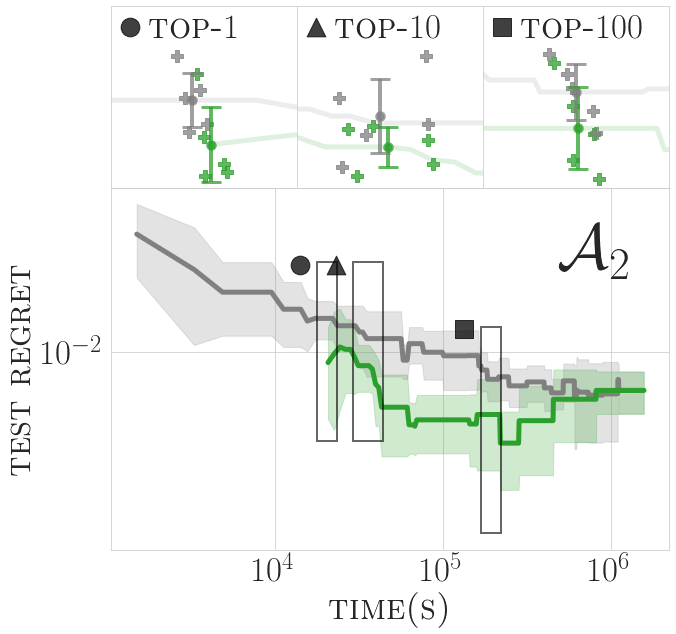

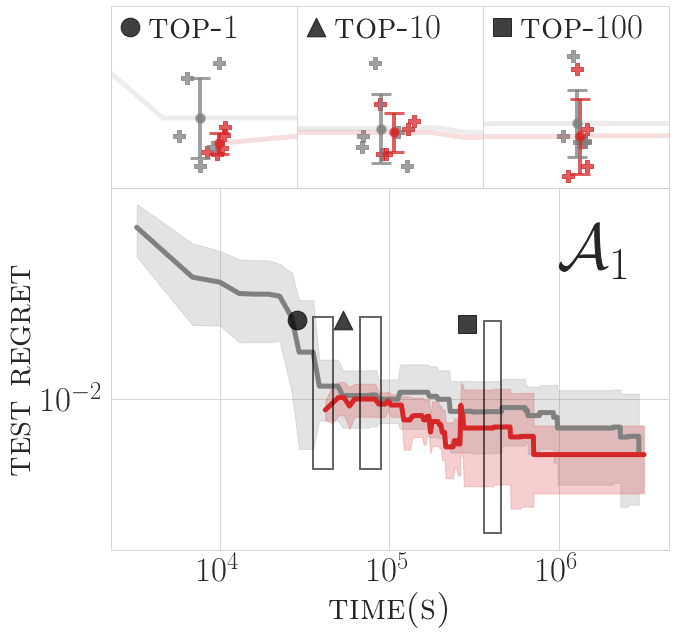

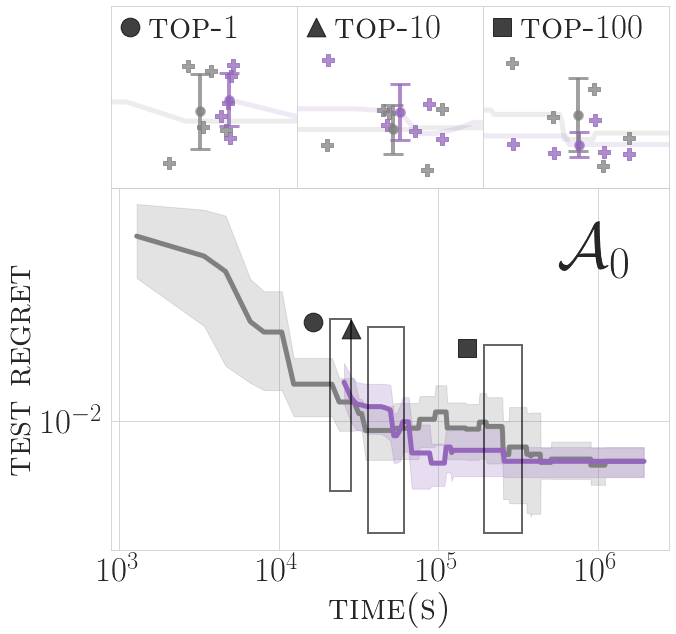

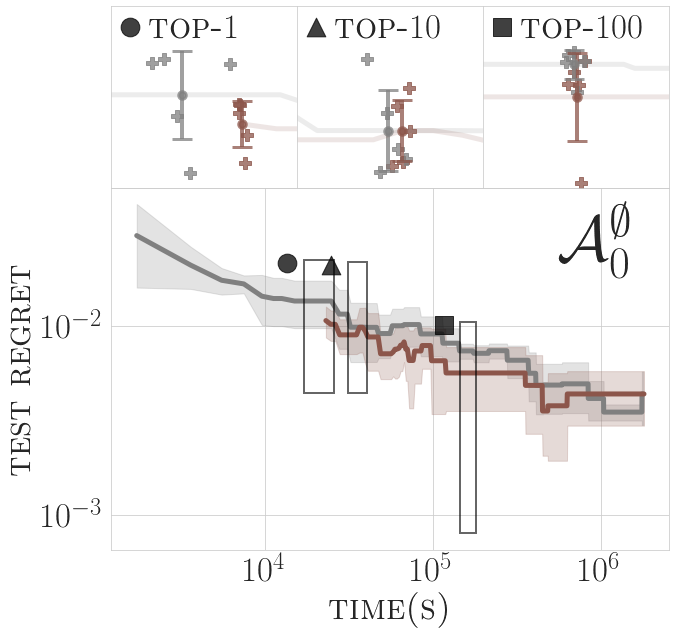

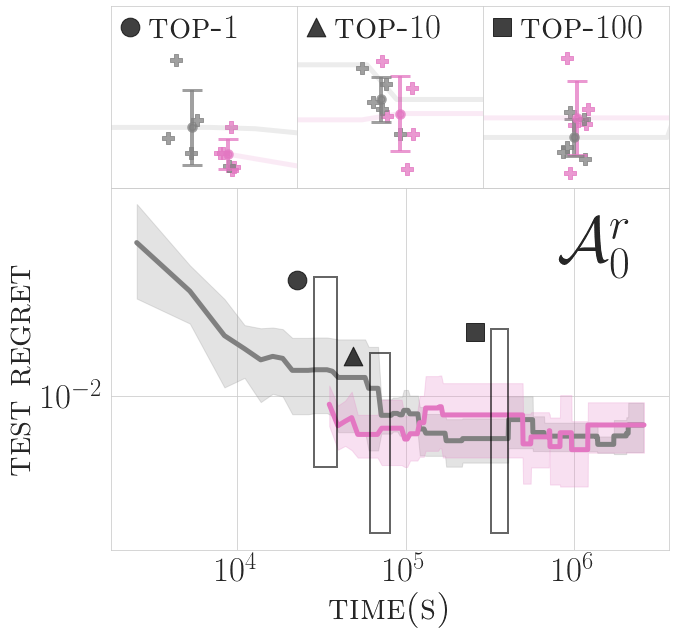

In [35]:
regrets = plot_avg_regrets("avg-3_ft_bn", all_regrets_ws, all_regrets_no_ws, all_times_ws, all_times_no_ws)

In [36]:
print_tests_results(regrets)

Search Space: 4

Top-1
Two-sided WilcoxonResult(statistic=0.0, pvalue=0.043114446783075355)
Greater WilcoxonResult(statistic=15.0, pvalue=0.021557223391537678)
Smaller WilcoxonResult(statistic=15.0, pvalue=0.9784427766084624)
Top-10
Two-sided WilcoxonResult(statistic=0.0, pvalue=0.043114446783075355)
Greater WilcoxonResult(statistic=15.0, pvalue=0.021557223391537678)
Smaller WilcoxonResult(statistic=15.0, pvalue=0.9784427766084624)
Top-100
Two-sided WilcoxonResult(statistic=4.0, pvalue=0.34523107177184)
Greater WilcoxonResult(statistic=4.0, pvalue=0.82738446411408)
Smaller WilcoxonResult(statistic=4.0, pvalue=0.17261553588592)


Search Space: 3

Top-1
Two-sided WilcoxonResult(statistic=3.0, pvalue=0.22491588401596185)
Greater WilcoxonResult(statistic=12.0, pvalue=0.11245794200798093)
Smaller WilcoxonResult(statistic=12.0, pvalue=0.887542057992019)
Top-10
Two-sided WilcoxonResult(statistic=2.0, pvalue=0.13801073756865956)
Greater WilcoxonResult(statistic=2.0, pvalue=0.9309946312156703)


/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/morestats.py:2879: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


### bns-ft single-path pro-rata

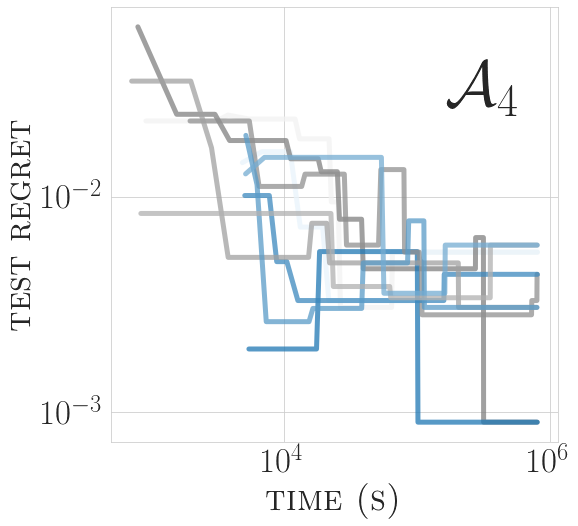

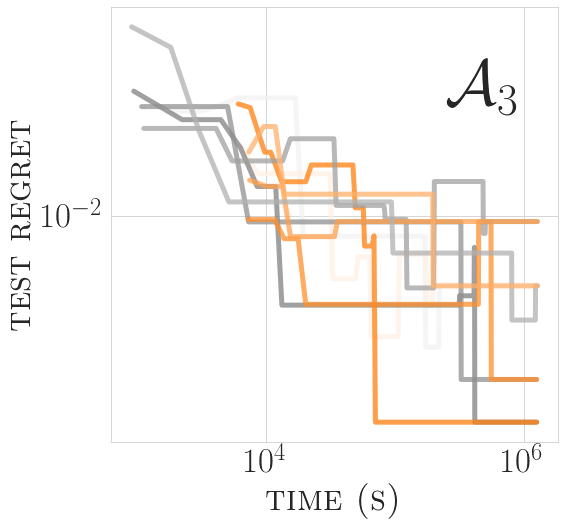

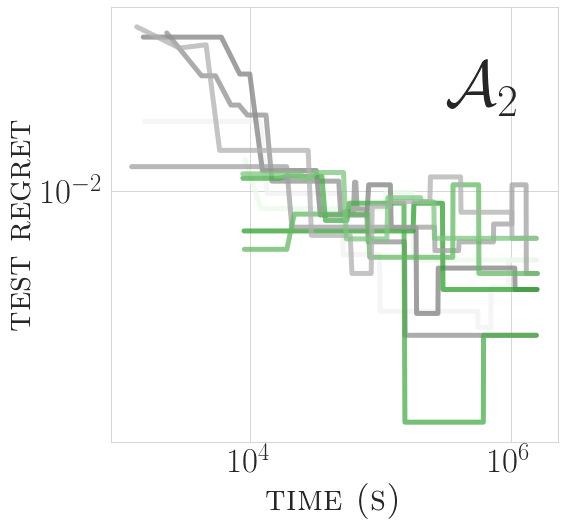

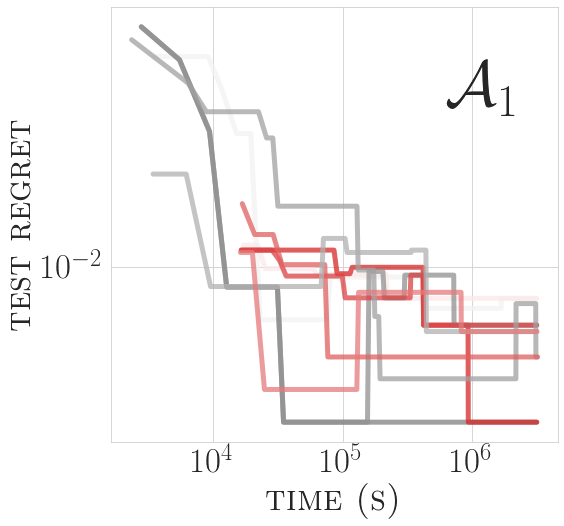

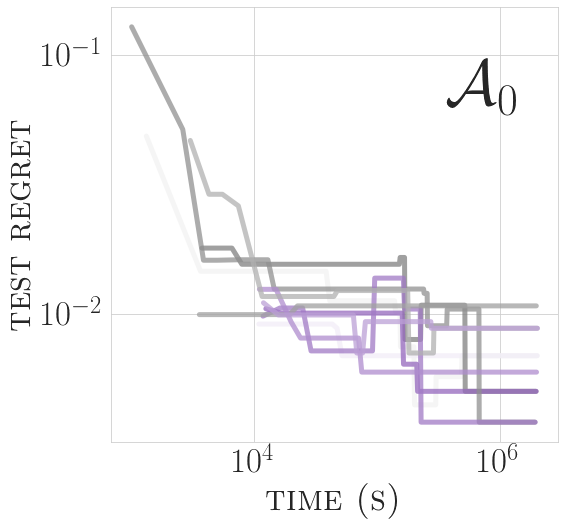

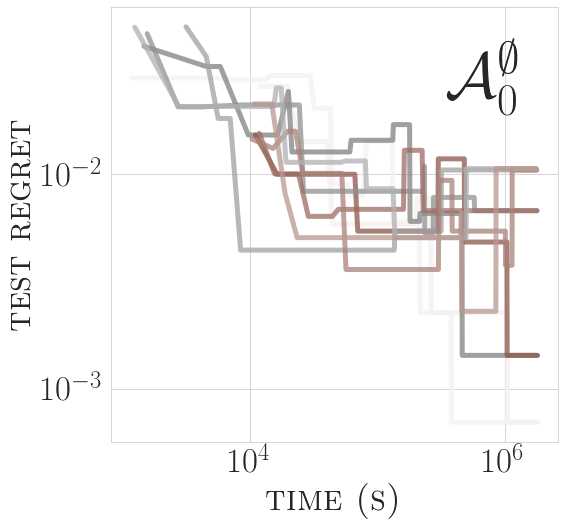

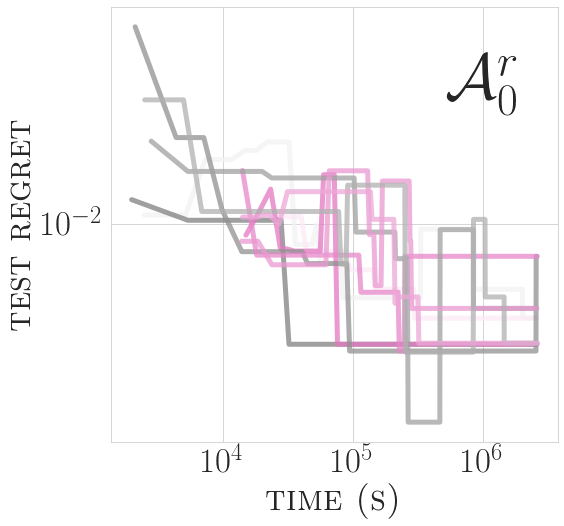

In [37]:
runs = range(5)
indexes = range(1000)
all_regrets_no_ws, all_regrets_ws, all_times_no_ws, all_times_ws = plot_individual_regrets("s-k+p-r_ft_bn", runs, indexes, ratio=4)

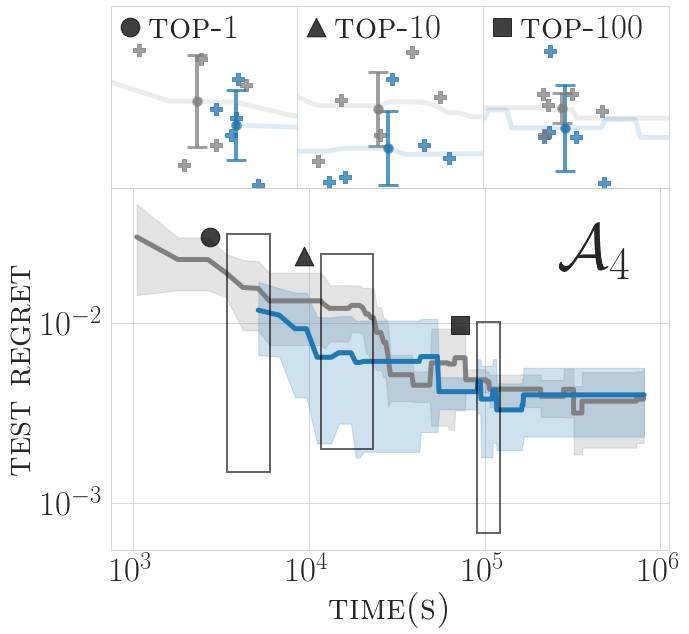

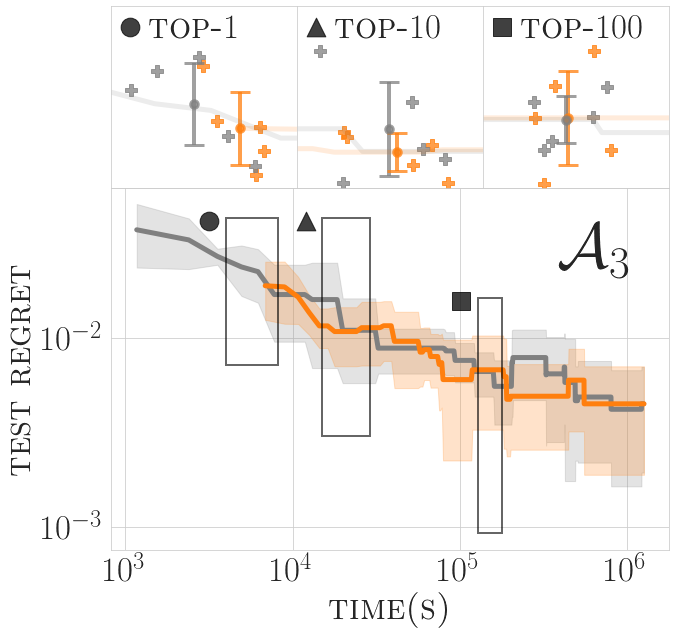

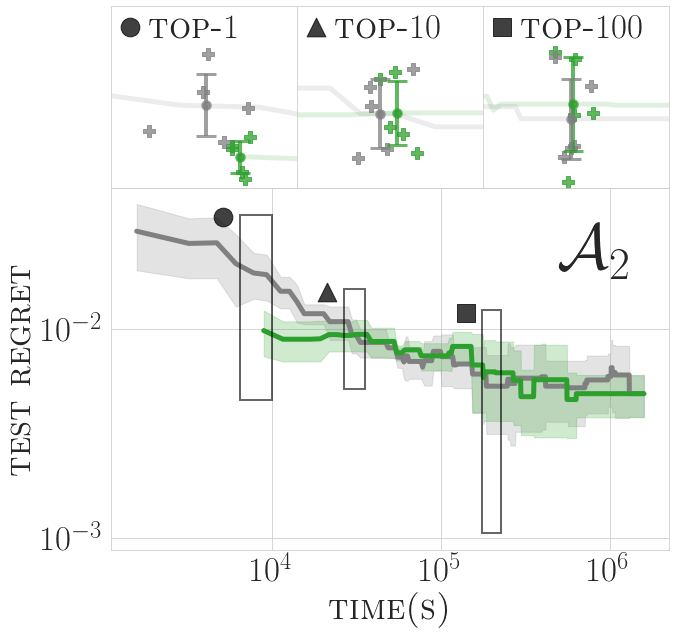

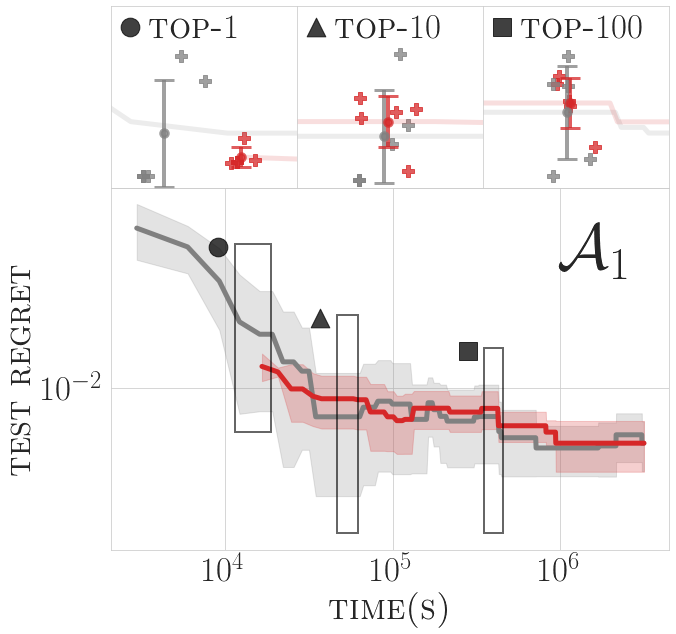

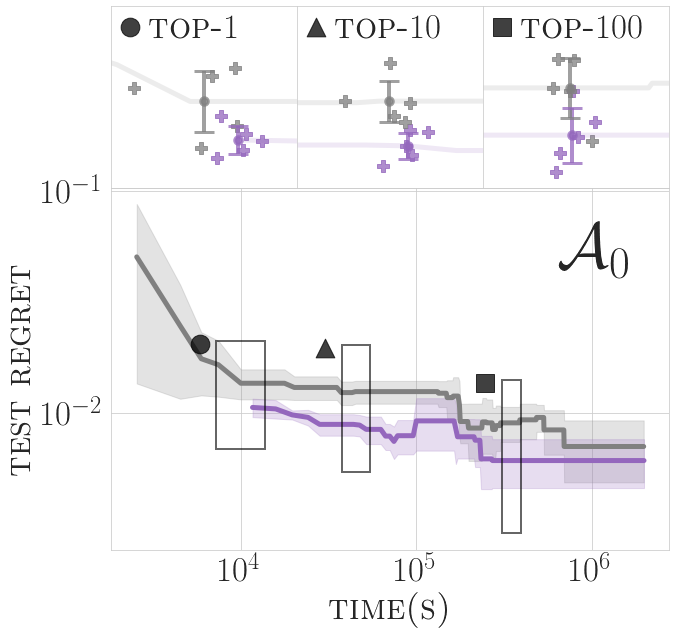

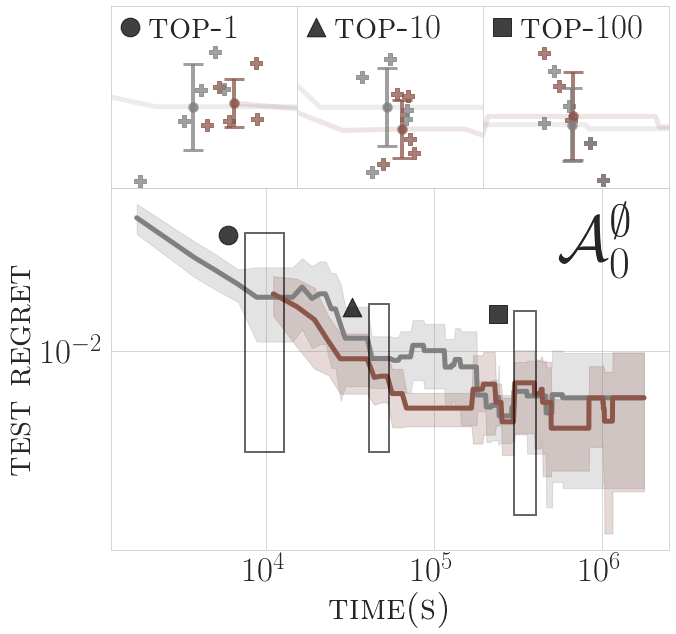

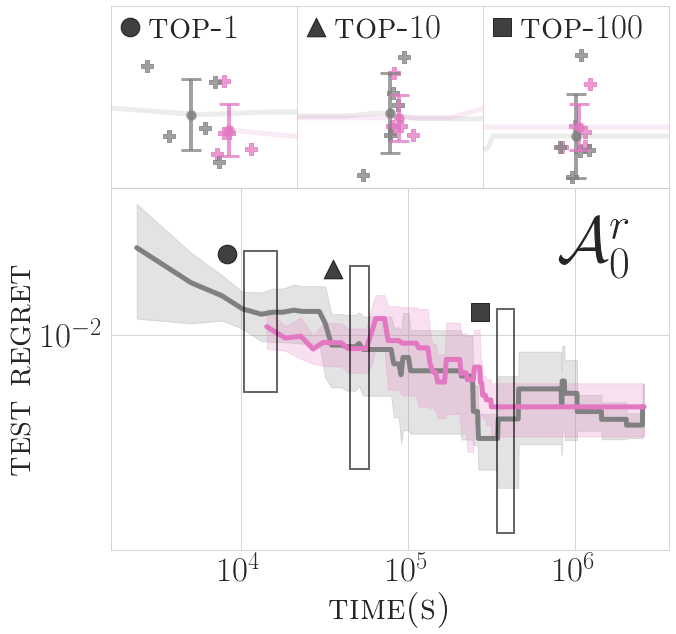

In [38]:
regrets = plot_avg_regrets("s-k+p-r_ft_bn", all_regrets_ws, all_regrets_no_ws, all_times_ws, all_times_no_ws)

In [39]:
print_tests_results(regrets)

Search Space: 4

Top-1
Two-sided WilcoxonResult(statistic=5.0, pvalue=0.5001842570707944)
Greater WilcoxonResult(statistic=5.0, pvalue=0.7499078714646028)
Smaller WilcoxonResult(statistic=5.0, pvalue=0.2500921285353972)
Top-10
Two-sided WilcoxonResult(statistic=2.0, pvalue=0.13801073756865956)
Greater WilcoxonResult(statistic=2.0, pvalue=0.9309946312156703)
Smaller WilcoxonResult(statistic=2.0, pvalue=0.06900536878432978)
Top-100
Two-sided WilcoxonResult(statistic=5.0, pvalue=0.5001842570707944)
Greater WilcoxonResult(statistic=5.0, pvalue=0.7499078714646028)
Smaller WilcoxonResult(statistic=5.0, pvalue=0.2500921285353972)


Search Space: 3

Top-1
Two-sided WilcoxonResult(statistic=5.0, pvalue=0.5001842570707944)
Greater WilcoxonResult(statistic=5.0, pvalue=0.7499078714646028)
Smaller WilcoxonResult(statistic=5.0, pvalue=0.2500921285353972)
Top-10
Two-sided WilcoxonResult(statistic=4.0, pvalue=0.34523107177184)
Greater WilcoxonResult(statistic=4.0, pvalue=0.82738446411408)
Smaller Wilc

/home/alois/anaconda3/envs/py36/lib/python3.7/site-packages/scipy/stats/morestats.py:2879: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")
